# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.001
use_generative_bias = True

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               use_generative_bias=use_generative_bias)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT.pth


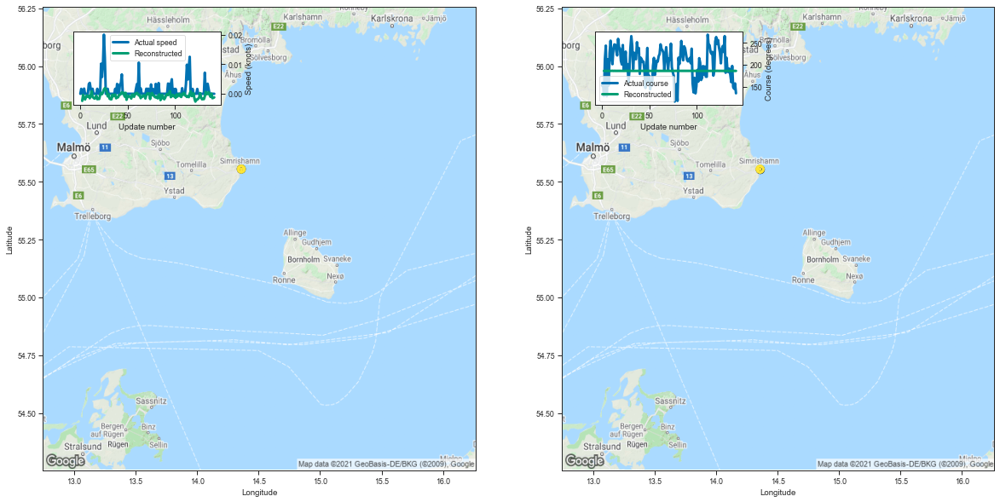

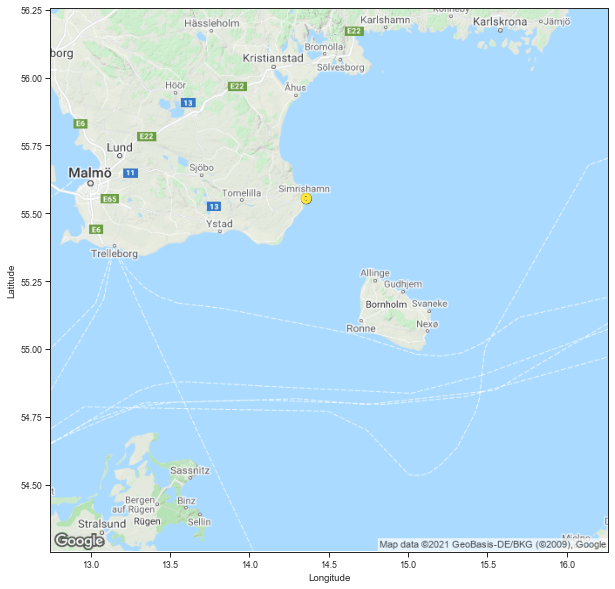

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  6962046  265759000  14.359659  55.554878  0.000000   
1                 0  6962046  265759000  14.359651  55.554905  0.001667   
2                 0  6962046  265759000  14.359662  55.554871  0.000000   
3                 0  6962046  265759000  14.359672  55.554893  0.000000   
4                 0  6962046  265759000  14.359683  55.554924  0.001754   
..              ...      ...        ...        ...        ...       ...   
138               0  6962046  265759000  14.359682  55.554882  0.000000   
139               0  6962046  265759000  14.359687  55.554901  0.000000   
140               0  6962046  265759000  14.359698  55.554886  0.000000   
141               0  6962046  265759000  14.359681  55.554882  0.000000   
142               0  6962046  265759000  14.359686  55.554871  0.000000   

         Course Ship type  Track length          Time stamp  
0    152.721664   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.359893,55.552914,-0.002401,186.156967,0.003392,0.003896,0.006837,99.118759
3,14.358532,55.554081,-0.000323,186.209076,0.003156,0.003708,0.005381,100.764543
4,14.358268,55.554485,-0.001347,186.155884,0.003076,0.003613,0.005510,101.075196
5,14.358199,55.553982,-0.001930,186.157898,0.003057,0.003591,0.005617,101.240755
6,14.358328,55.554501,-0.001147,186.192139,0.003057,0.003622,0.005053,101.403597
...,...,...,...,...,...,...,...,...
138,14.358360,55.554497,-0.001014,186.187576,0.003037,0.003605,0.004991,101.398348
139,14.357888,55.554363,0.000065,186.126022,0.003040,0.003585,0.005262,101.291229
140,14.358623,55.554420,-0.001489,186.266708,0.003026,0.003634,0.004681,101.485687
141,14.358657,55.554451,-0.001388,186.156479,0.003045,0.003583,0.005080,101.387161


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT.pth


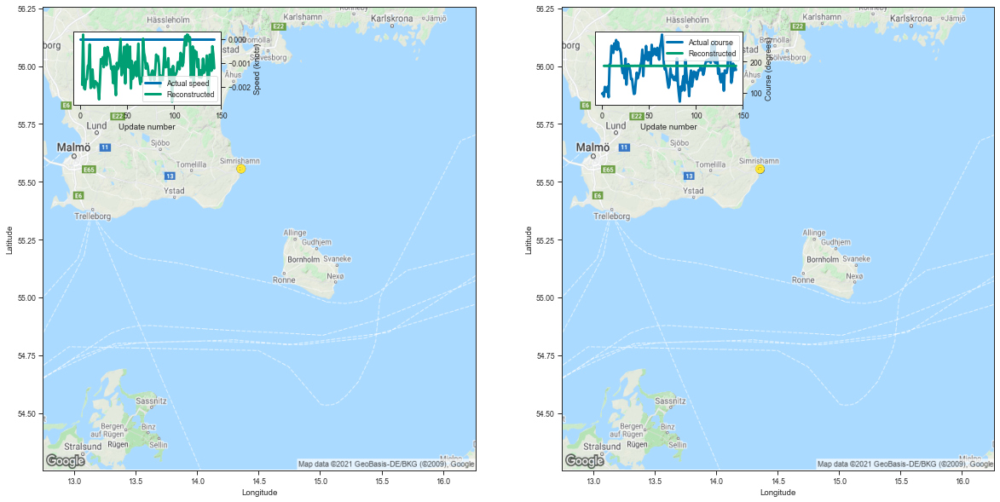

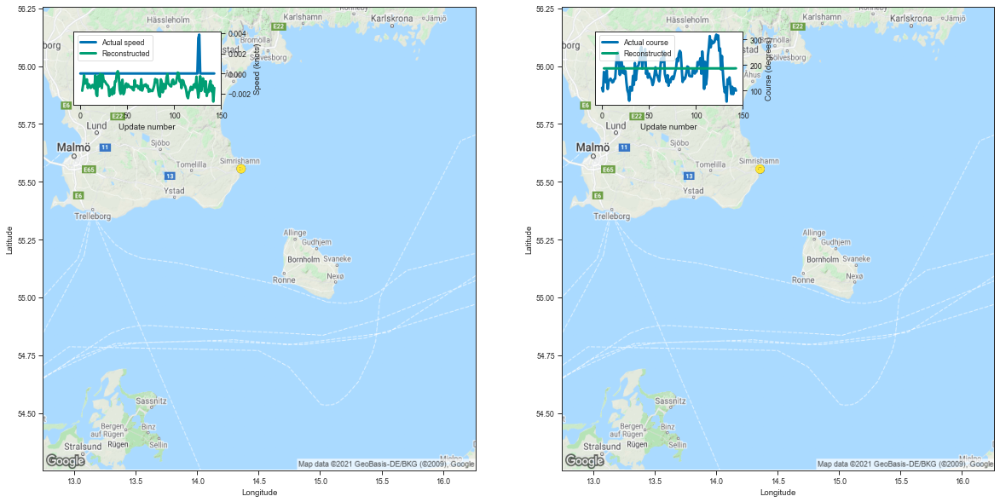

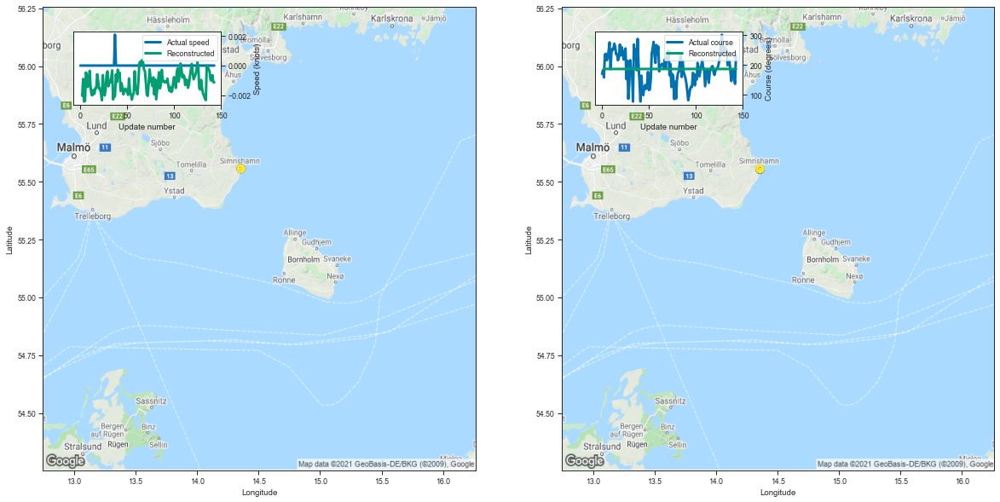

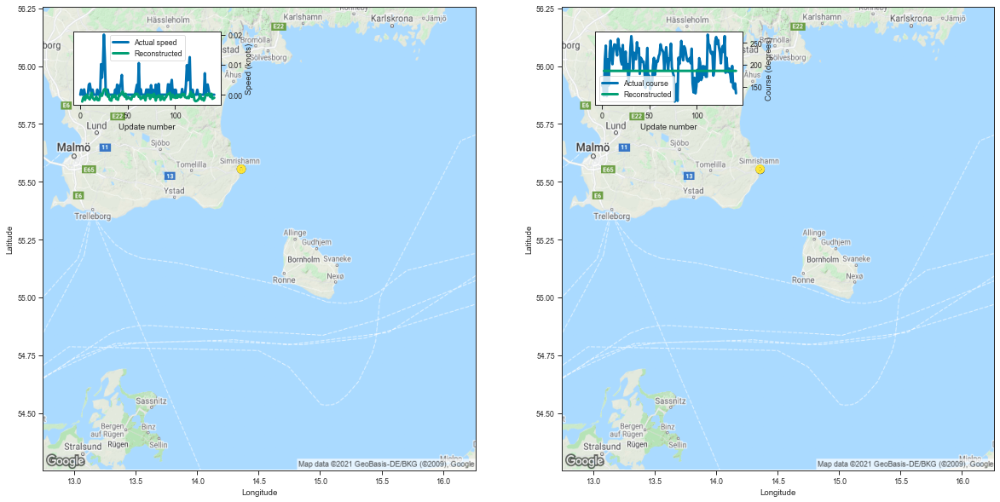

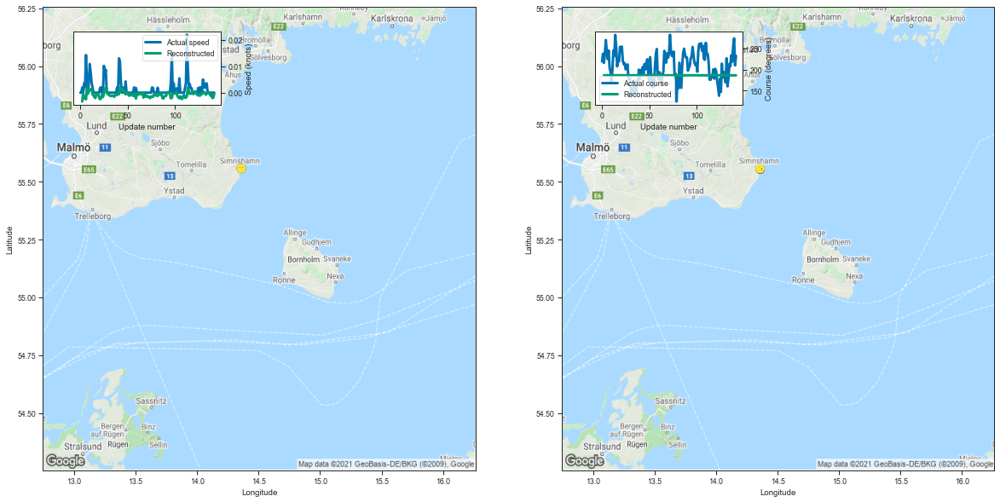

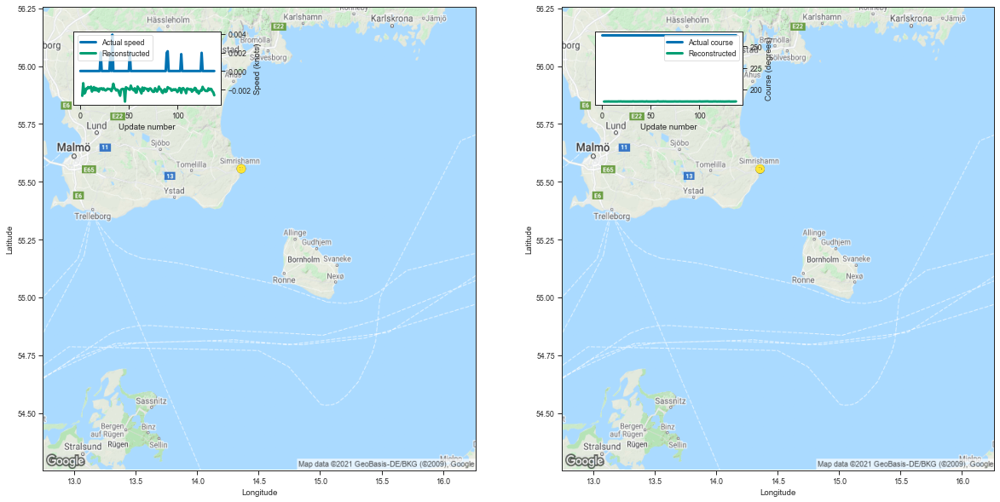

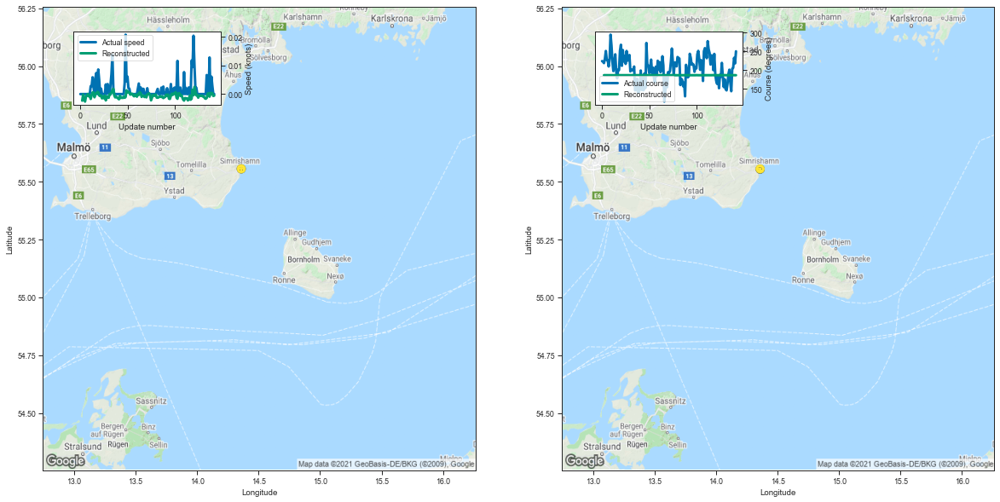

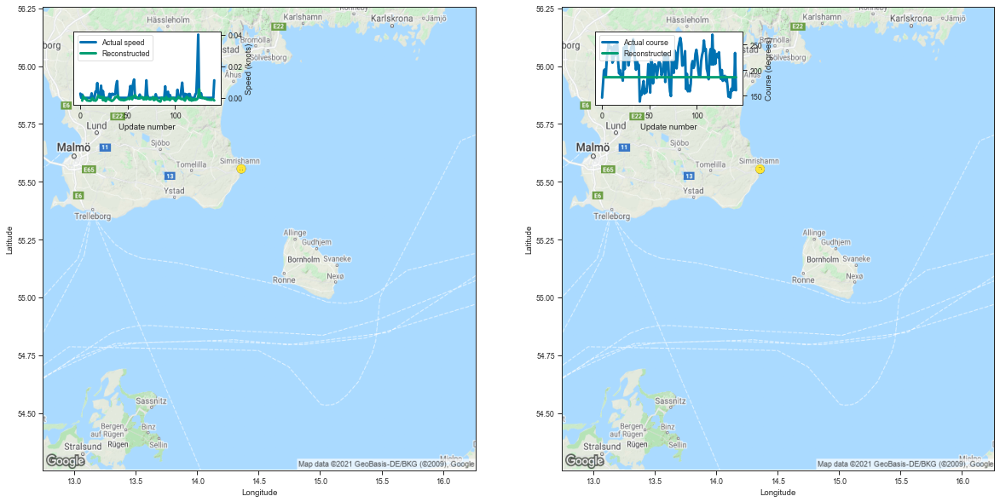

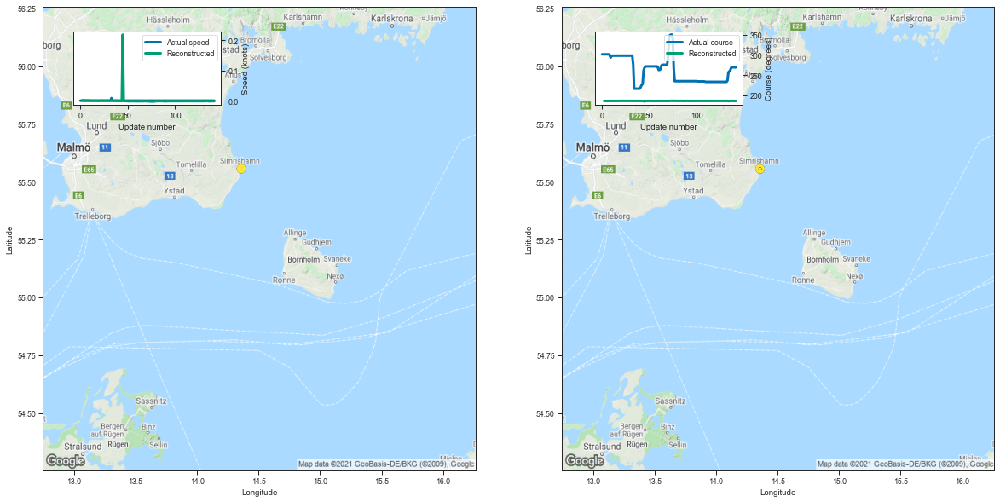

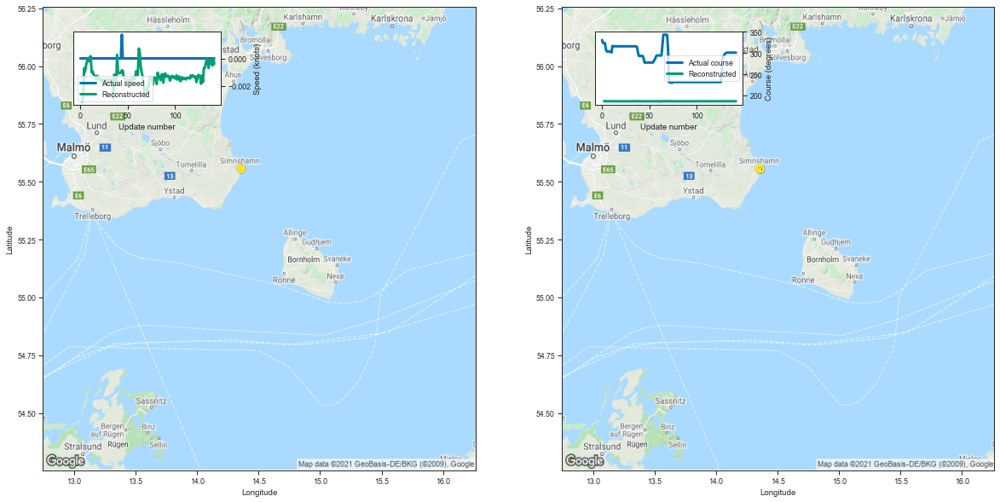

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
25,25,7292936,266054000,Fishing,144,1149.040283,7.979446
34,34,7237328,266054000,Fishing,144,1145.063599,7.951831
44,44,7135380,266054000,Fishing,144,1138.360229,7.905279
74,74,6962046,265759000,Fishing,143,1108.200439,7.749653
17,17,6685896,265759000,Fishing,143,1107.583984,7.745343
43,43,5760657,265750000,Fishing,139,1070.962158,7.704764
29,29,6787151,265759000,Fishing,143,1101.244995,7.701014
60,60,6869996,265759000,Fishing,143,1098.800049,7.683916
103,103,6064863,265754000,Fishing,143,1098.196533,7.679696
42,42,5972813,265754000,Fishing,143,1074.396729,7.513264


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT.pth


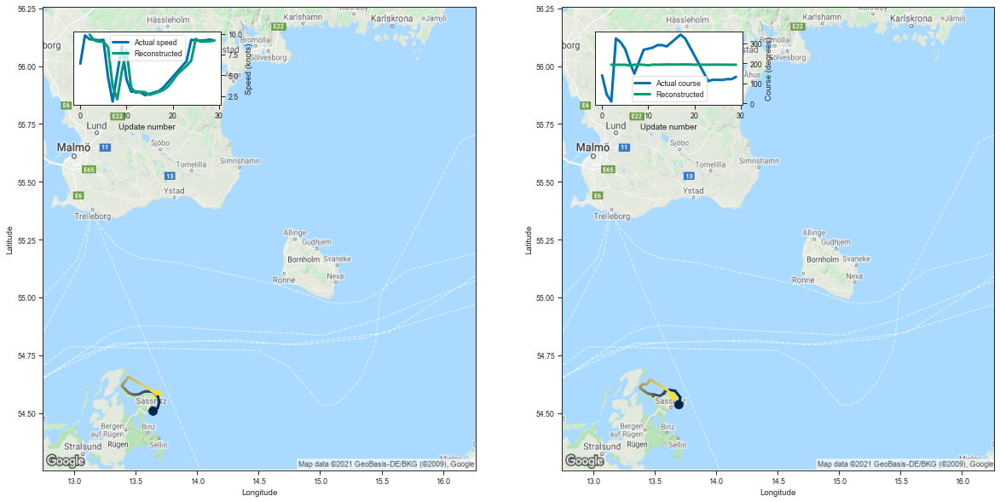

[9.892151832580566, 9.195732116699219, 9.047735214233398, 9.03274917602539]


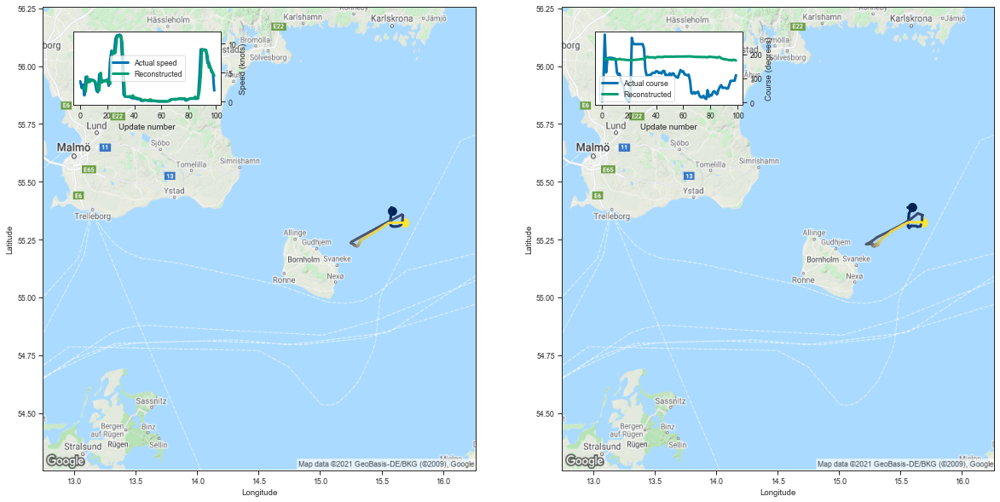

[2.2823667526245117, 2.6492786407470703, 1.6952781677246094, 4.346916198730469]


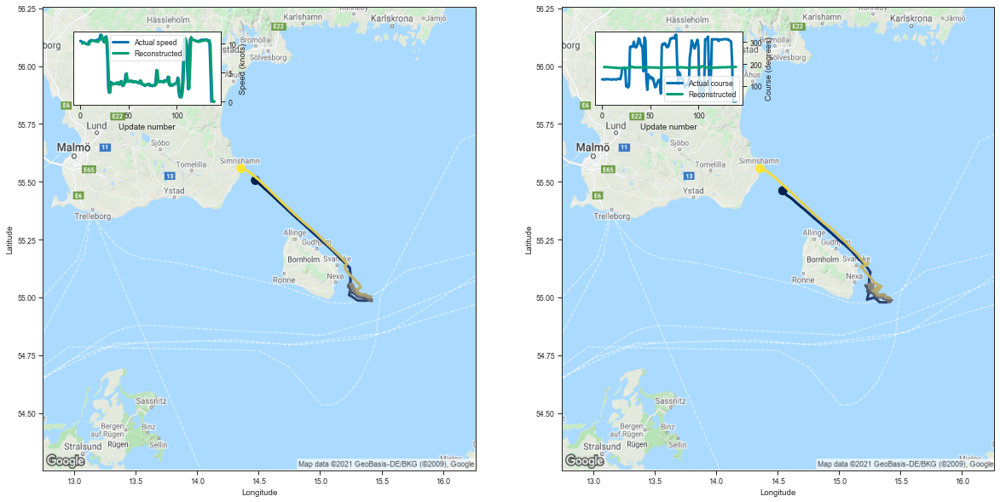

[10.007399559020996, 10.278778076171875, 10.137872695922852, 10.109090805053711]


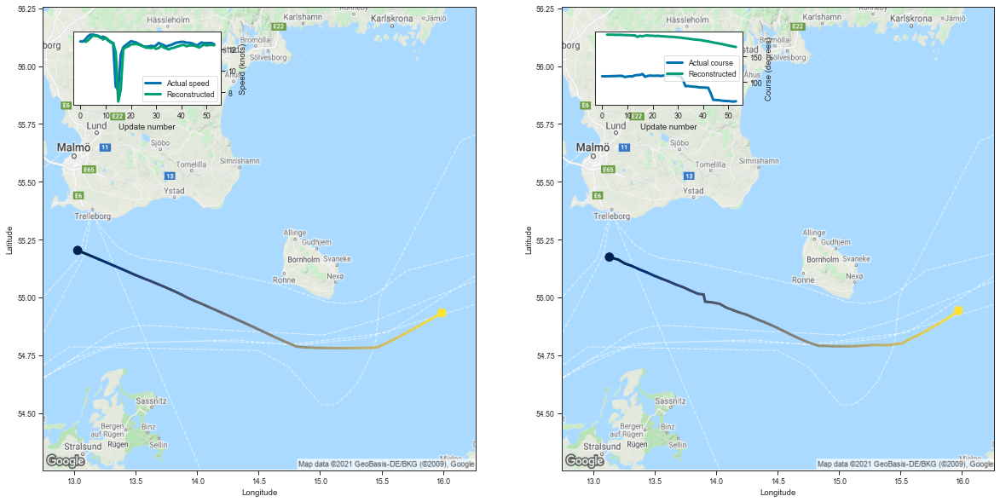

[12.663558959960938, 12.795467376708984, 13.036571502685547, 13.250022888183594]


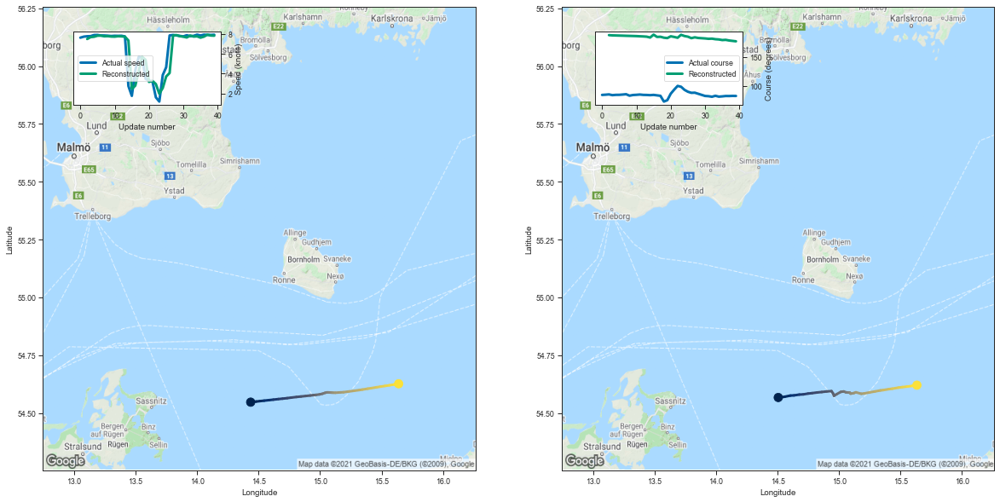

[7.488574028015137, 7.677958011627197, 7.714742183685303, 7.820760250091553]


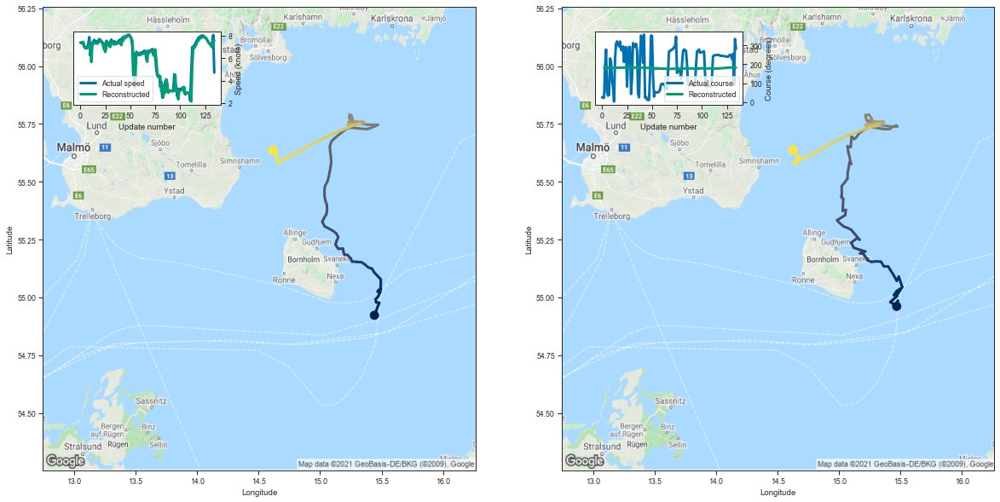

[7.385373115539551, 7.434820175170898, 7.0953874588012695, 6.8968987464904785]


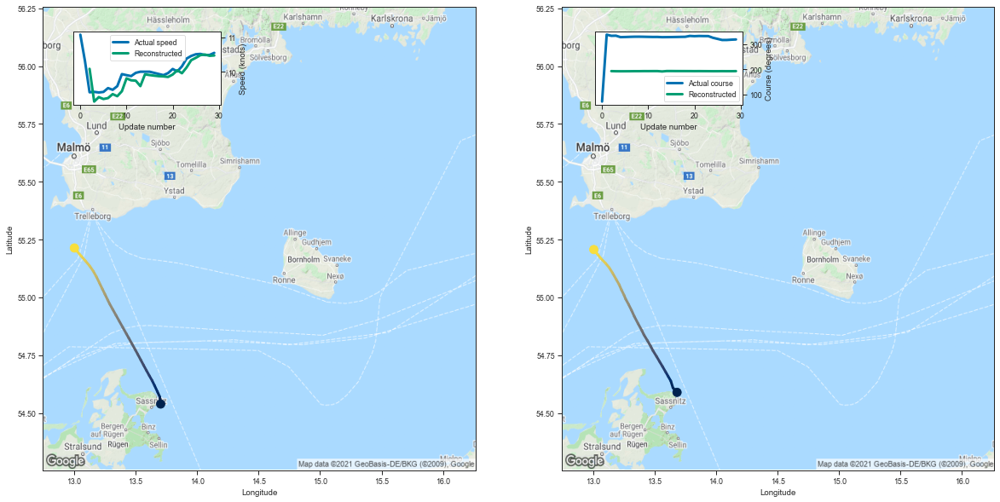

[10.0841064453125, 9.129021644592285, 9.259065628051758, 9.203703880310059]


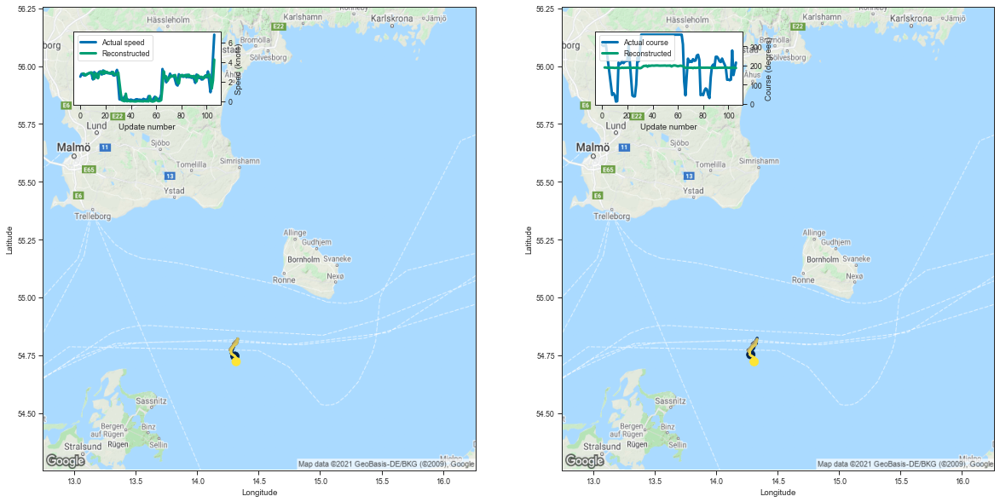

[2.8117921352386475, 2.7913734912872314, 2.6130950450897217, 2.701432704925537]


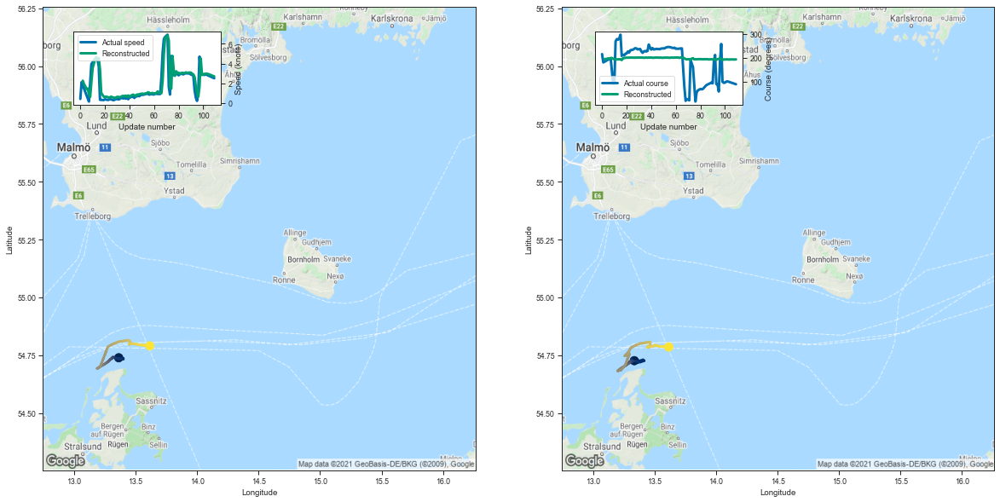

[2.2513785362243652, 1.9027973413467407, 1.6913654804229736, 1.3921029567718506]


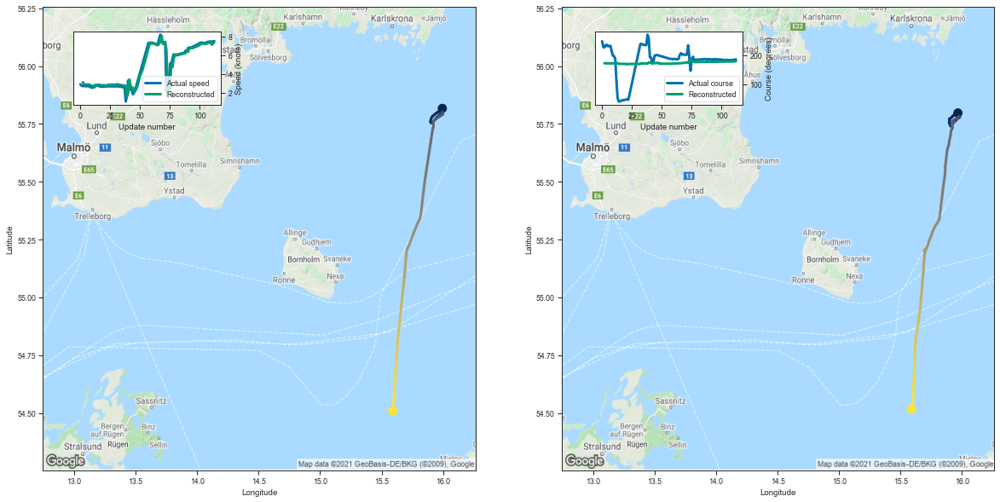

[3.102975368499756, 2.8879075050354004, 2.8543877601623535, 2.850792407989502]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
73,73,1113112,211542610,Fishing,30,-82.354599,-2.745153
5,5,6496,211215500,Fishing,100,-215.096039,-2.150960
91,91,5598936,265750000,Fishing,140,-157.570633,-1.125505
36,36,7969192,273352230,Fishing,54,-56.812649,-1.052086
67,67,1070020,211474000,Fishing,40,-42.050900,-1.051272
49,49,1557318,219021428,Fishing,135,-140.611526,-1.041567
101,101,1176042,211755650,Fishing,30,-12.761396,-0.425380
30,30,1149722,211551270,Fishing,107,-42.384586,-0.396118
21,21,19488,211243240,Fishing,110,-34.380634,-0.312551
33,33,4352040,261015270,Fishing,113,13.199127,0.116806


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT.pth


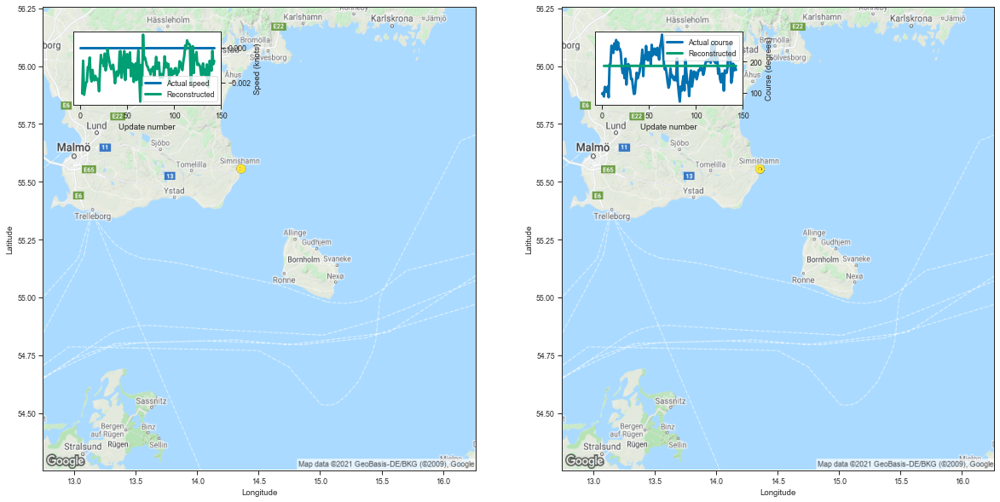

[-0.0026307106018066406, -0.0007457733154296875, -0.002702474594116211, -0.0023686885833740234]


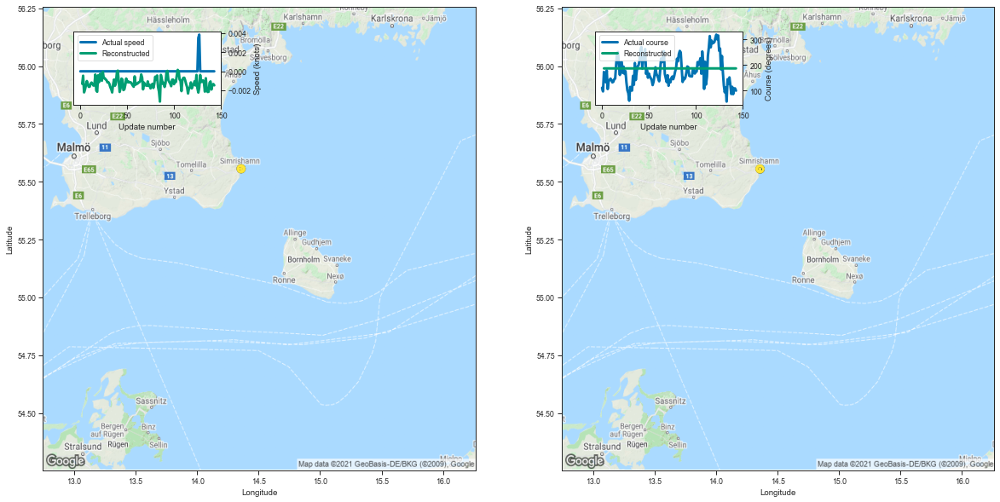

[-0.0013096332550048828, -0.00046515464782714844, -0.0022089481353759766, -0.0018877983093261719]


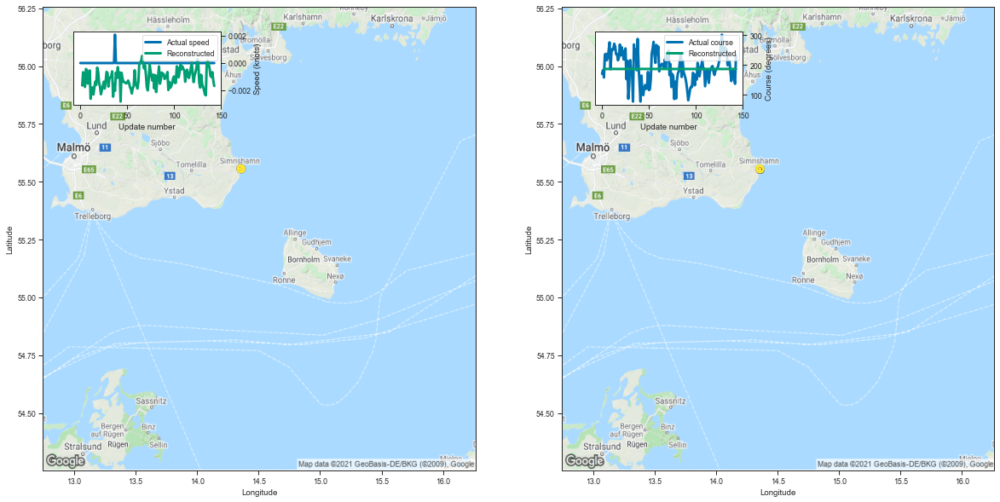

[-0.0016429424285888672, -0.0006749629974365234, -0.0016143321990966797, -0.0017495155334472656]


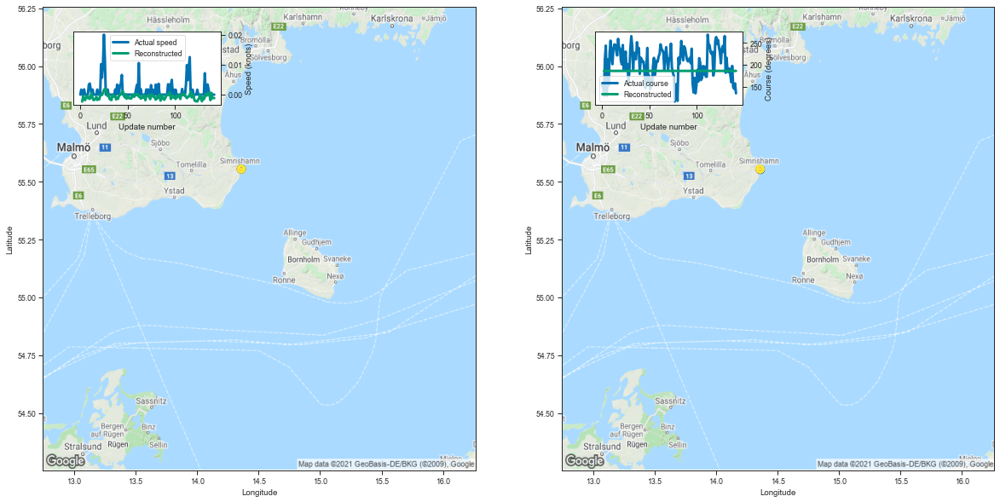

[-0.002315044403076172, -0.00043320655822753906, -0.0014111995697021484, -0.0018475055694580078]


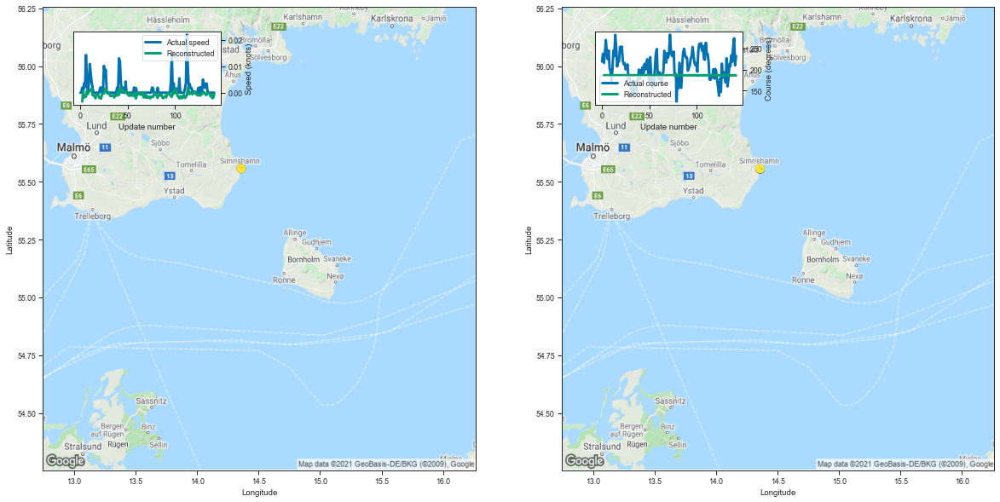

[-0.0033621788024902344, 0.0004947185516357422, -0.0018405914306640625, -0.0014264583587646484]


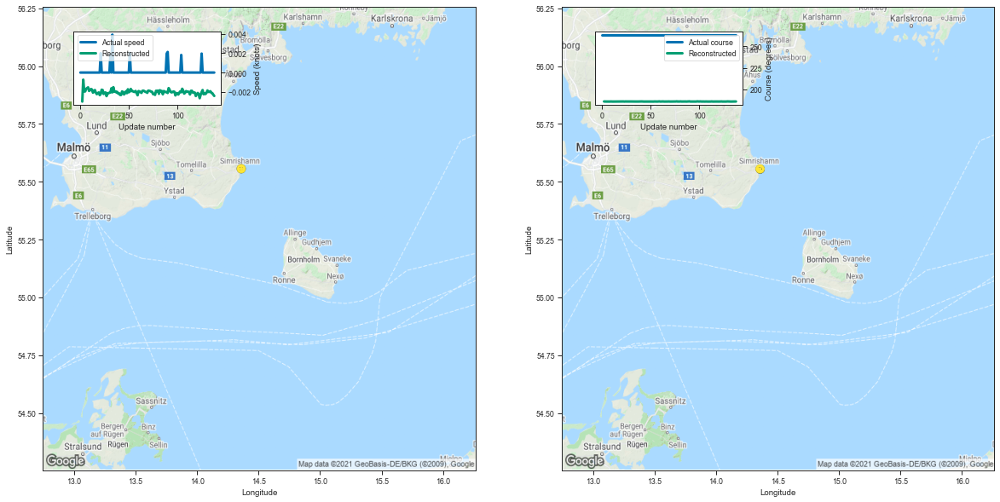

[-0.0030012130737304688, -0.000736236572265625, -0.0019571781158447266, -0.0019488334655761719]


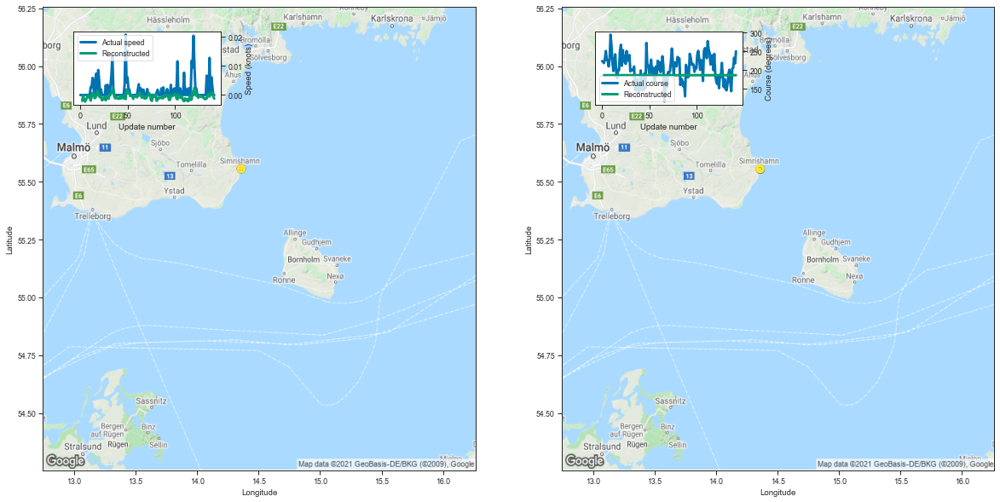

[-0.002043008804321289, -9.799003601074219e-05, -0.001683950424194336, -0.002264261245727539]


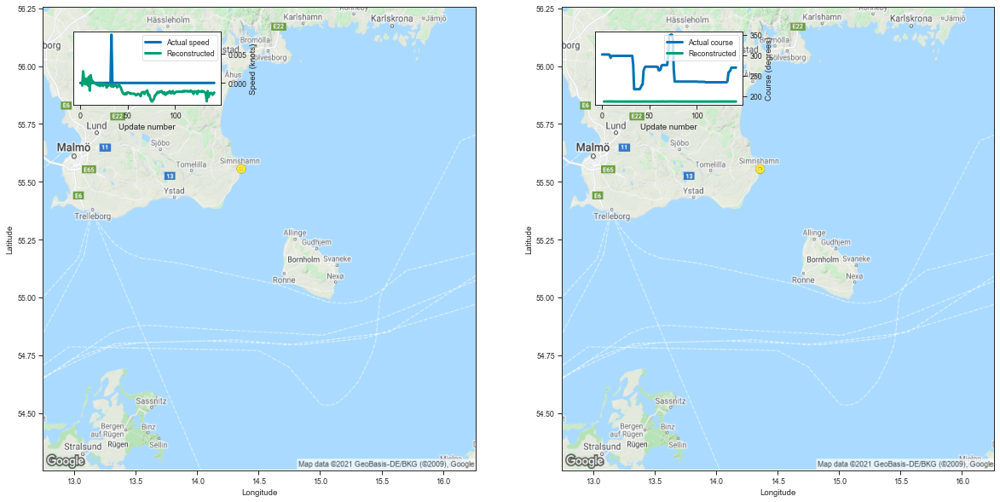

[-0.00045800209045410156, 0.002008199691772461, 0.00038909912109375, -0.00023651123046875]


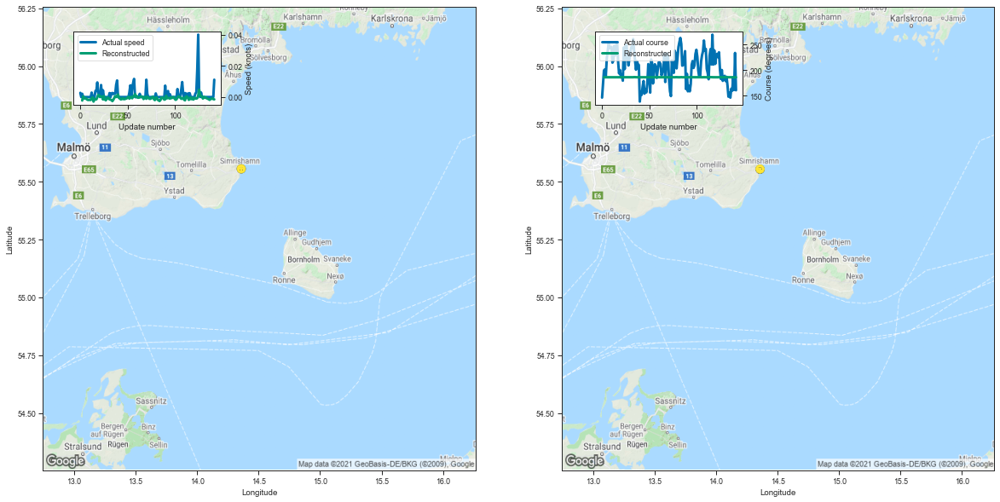

[-0.0022356510162353516, 0.00048279762268066406, -0.0007383823394775391, -0.0009388923645019531]


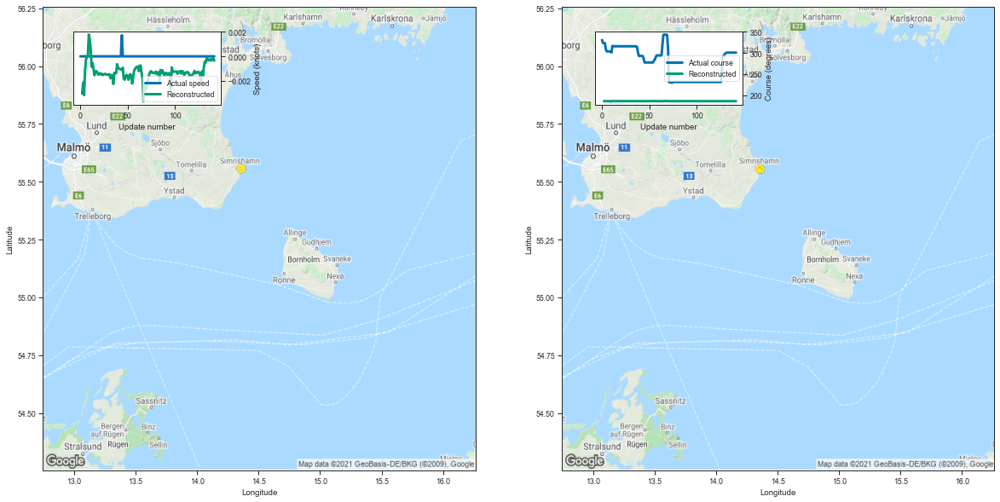

[-0.0030574798583984375, -0.00214385986328125, -0.0031828880310058594, -0.0012040138244628906]


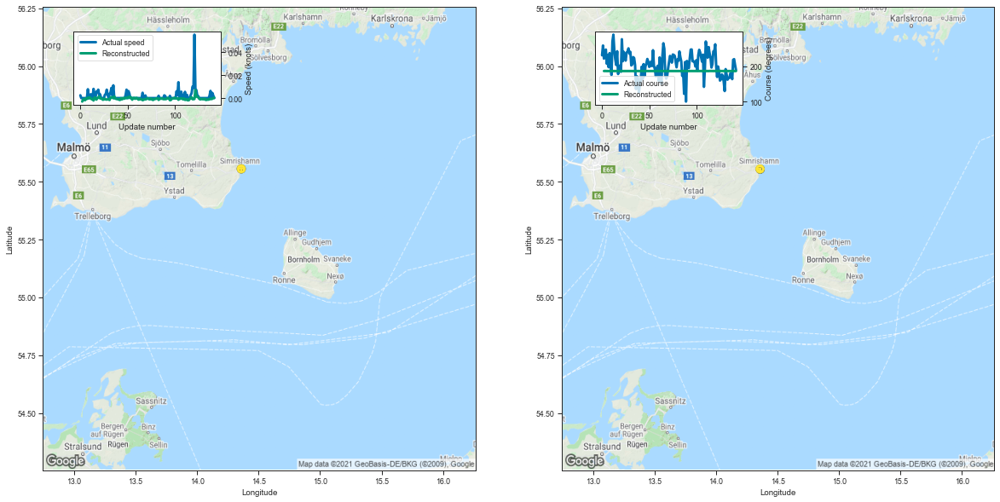

[-0.003018617630004883, -0.0010421276092529297, -0.0012683868408203125, -0.0018312931060791016]


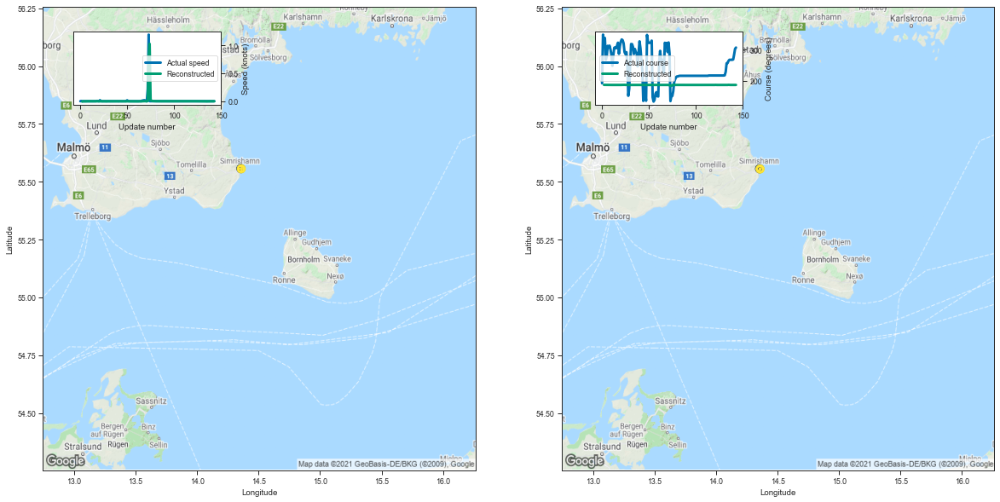

[-0.00671076774597168, -0.00144195556640625, -0.0023903846740722656, -0.0024607181549072266]


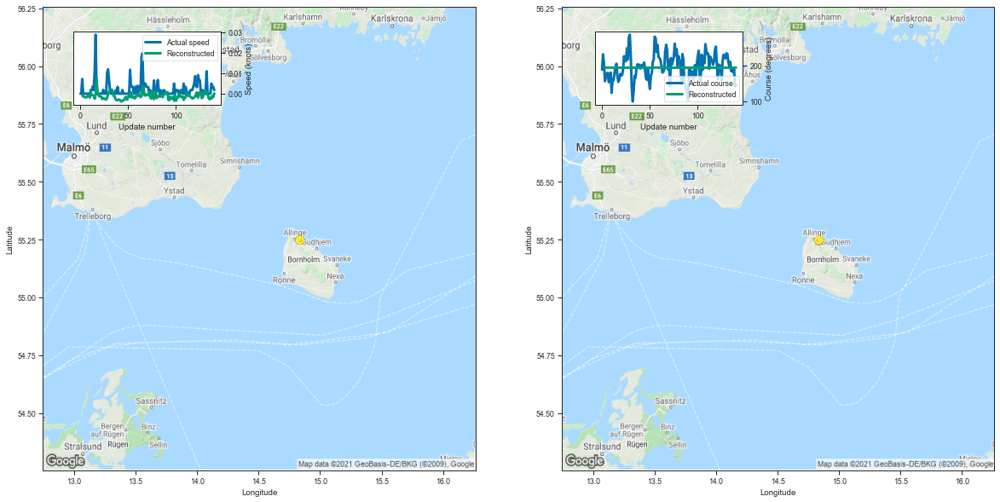

[-0.0004565715789794922, -0.0014057159423828125, -0.0014483928680419922, -0.0017681121826171875]


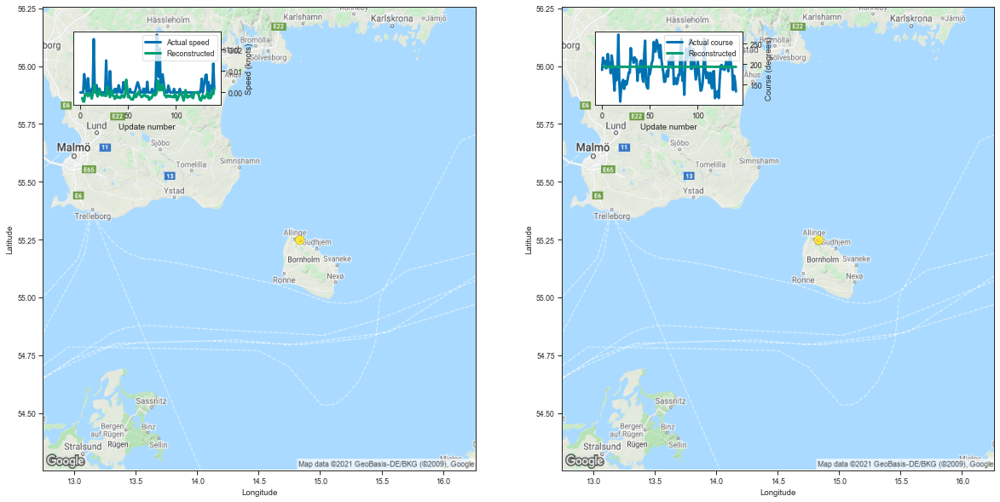

[-0.0025835037231445312, -0.004232168197631836, -0.004267215728759766, -0.0006625652313232422]


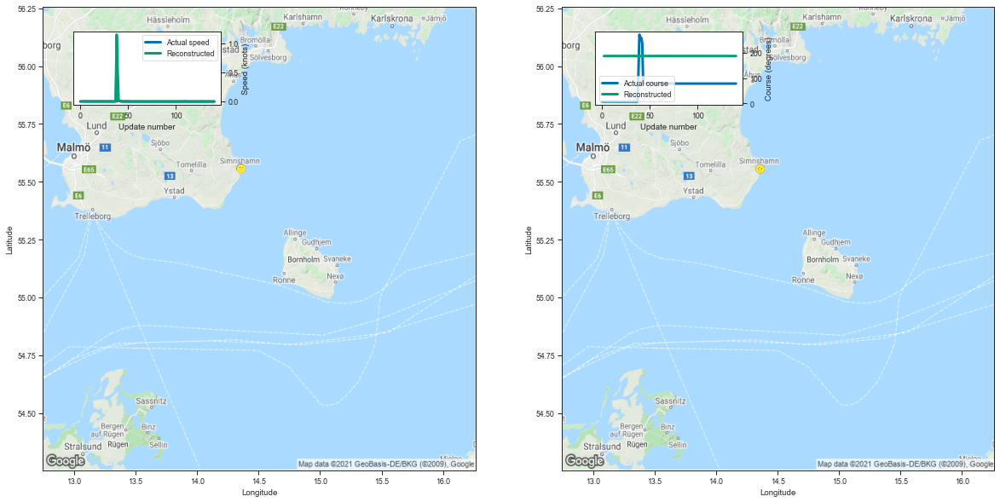

[0.0015864372253417969, 0.002814769744873047, 0.0009353160858154297, 0.0005161762237548828]


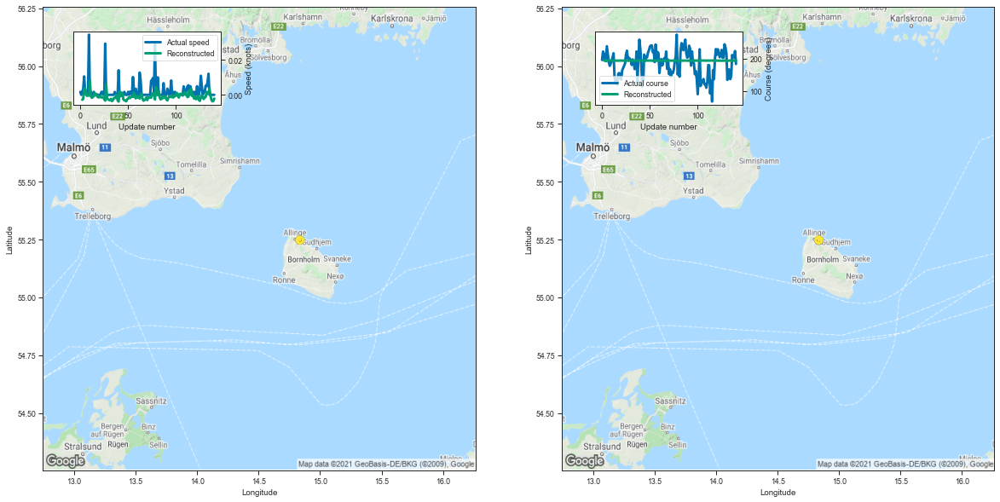

[-0.0028617382049560547, -0.002316713333129883, 0.0032570362091064453, 0.0037343502044677734]


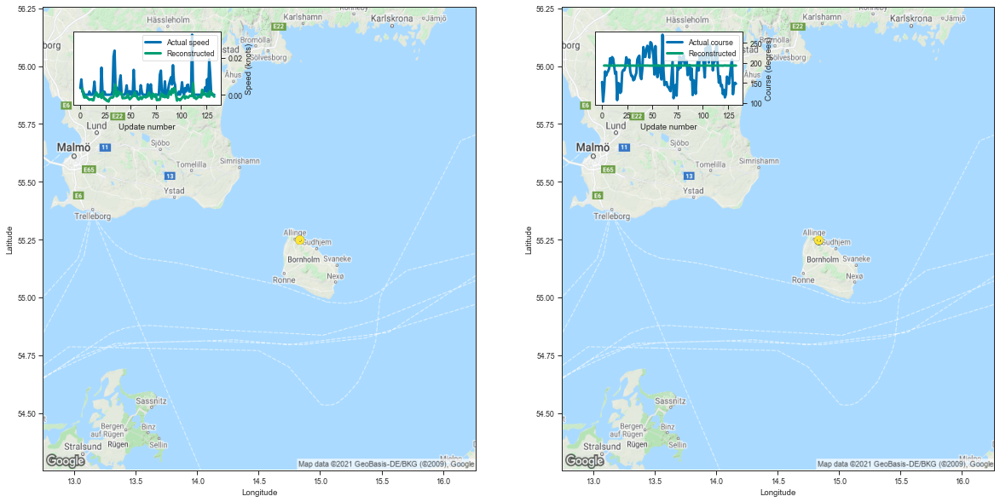

[0.0033724308013916016, 5.841255187988281e-05, -0.0015685558319091797, -0.0005578994750976562]


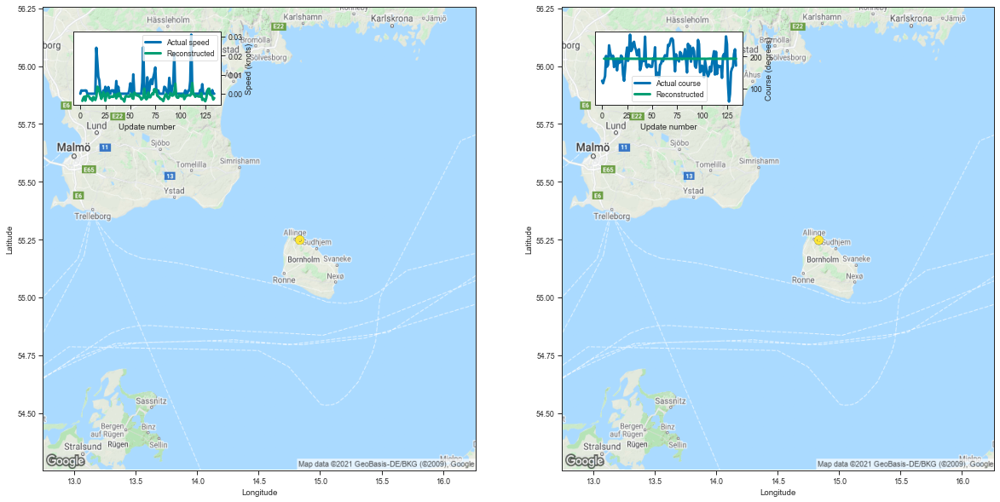

[-0.0037720203399658203, -0.0022847652435302734, -0.0015337467193603516, -0.0036602020263671875]


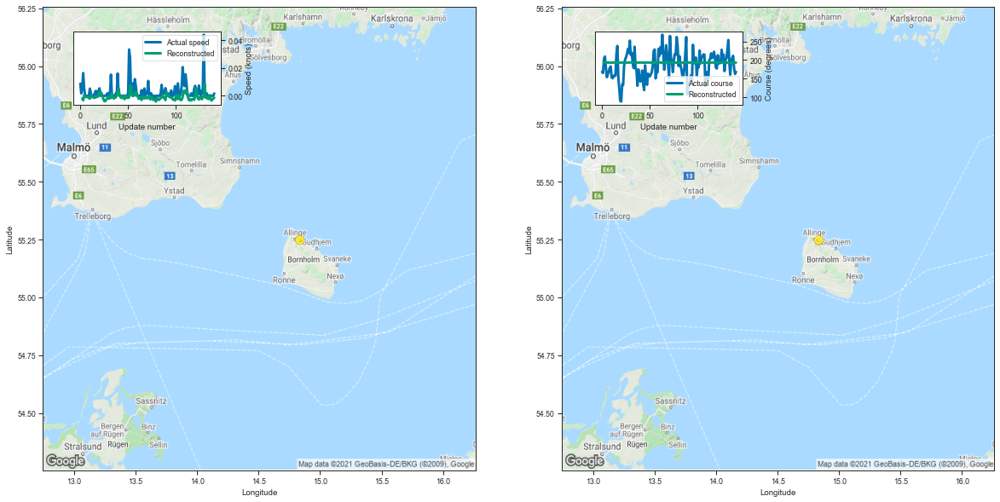

[-0.002077817916870117, -0.0032129287719726562, 0.00037980079650878906, -0.0003952980041503906]


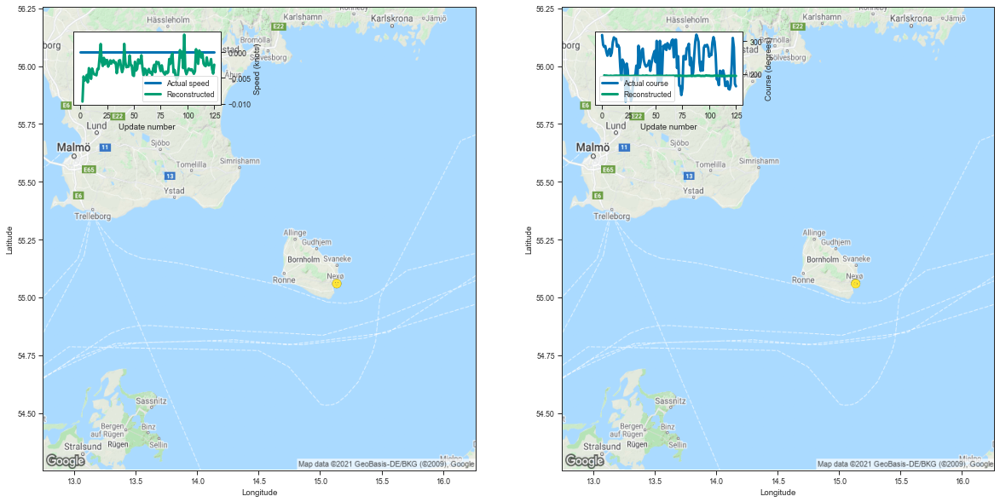

[-0.009592771530151367, -0.004721879959106445, -0.005483865737915039, -0.005379676818847656]


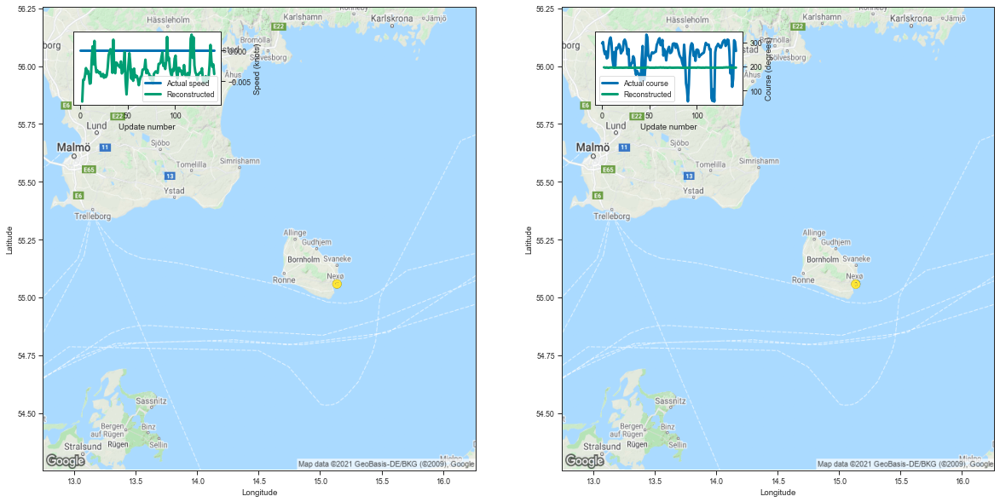

[-0.008328437805175781, -0.004793882369995117, -0.004801750183105469, -0.004060029983520508]


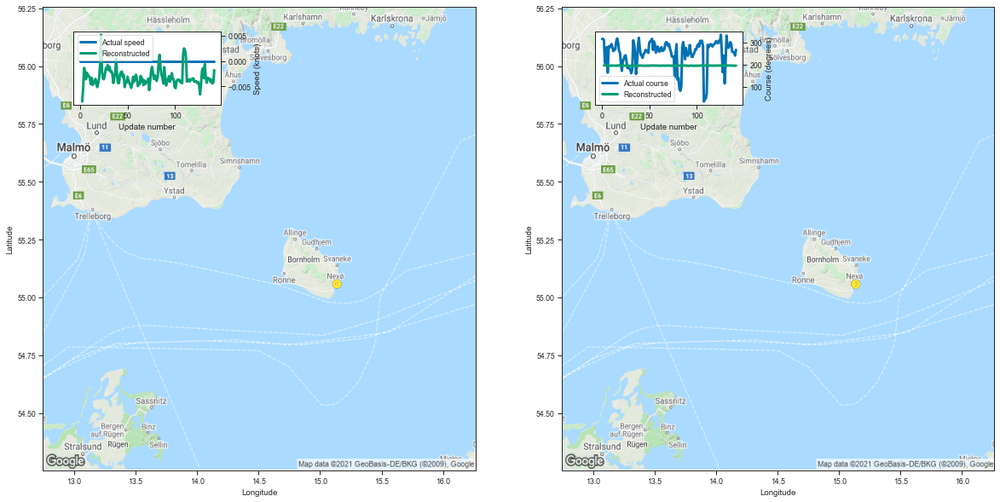

[-0.008037805557250977, -0.005376338958740234, -0.0013585090637207031, -0.0020568370819091797]


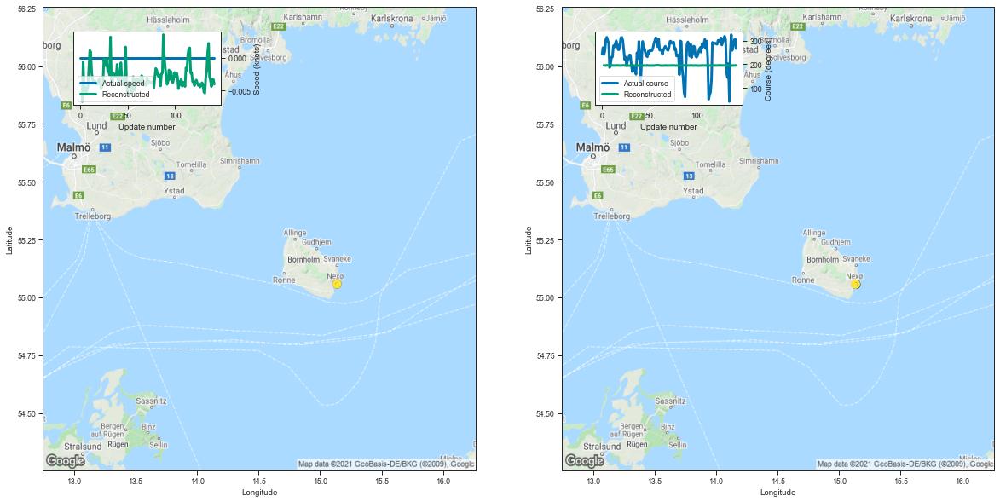

[-0.006632566452026367, -0.0006775856018066406, -0.005009174346923828, -0.004419088363647461]


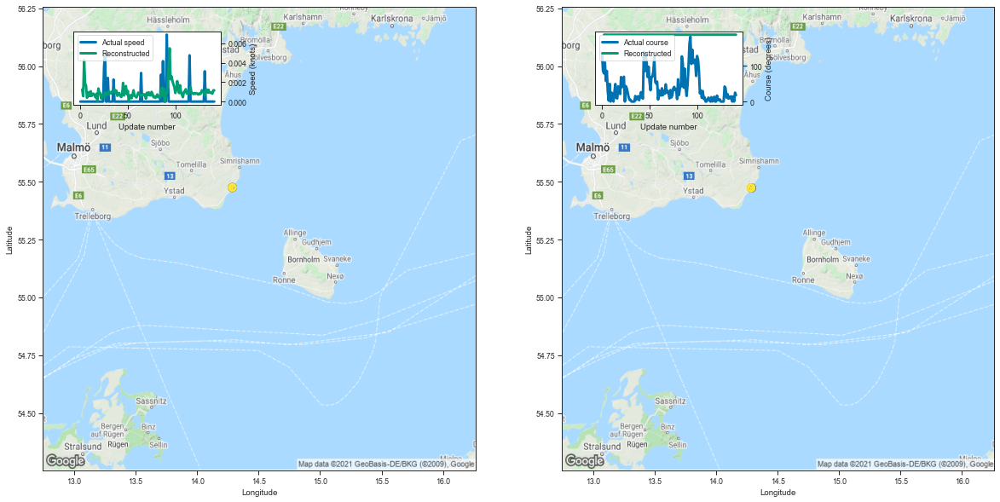

[0.0012426376342773438, 0.0005495548248291016, 0.004256248474121094, 0.0018725395202636719]


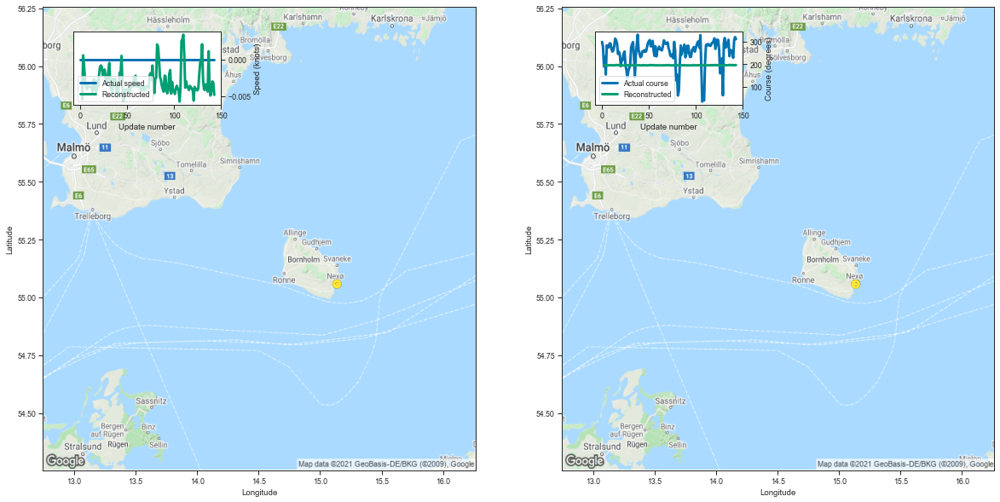

[-0.005445003509521484, 0.0005767345428466797, -0.0008747577667236328, -0.002908468246459961]


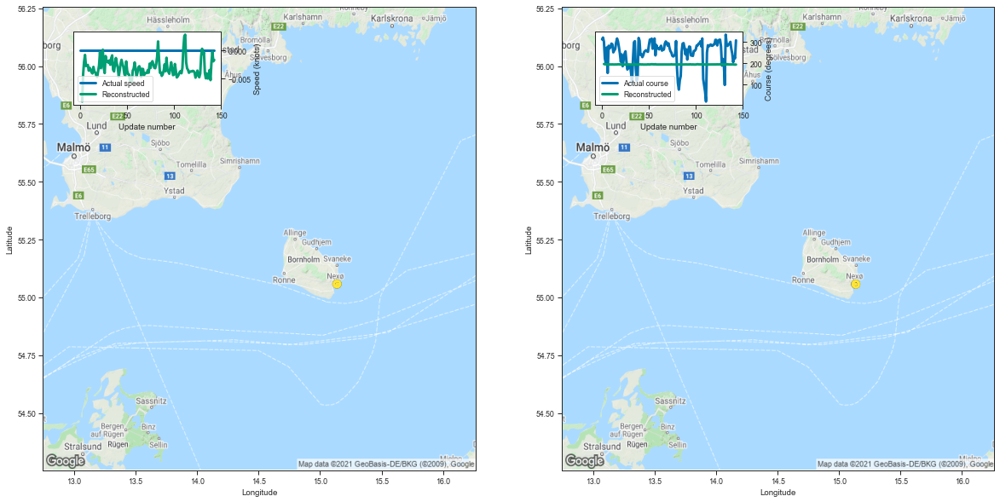

[-0.009070873260498047, -0.004172325134277344, -0.0019805431365966797, -0.000762939453125]


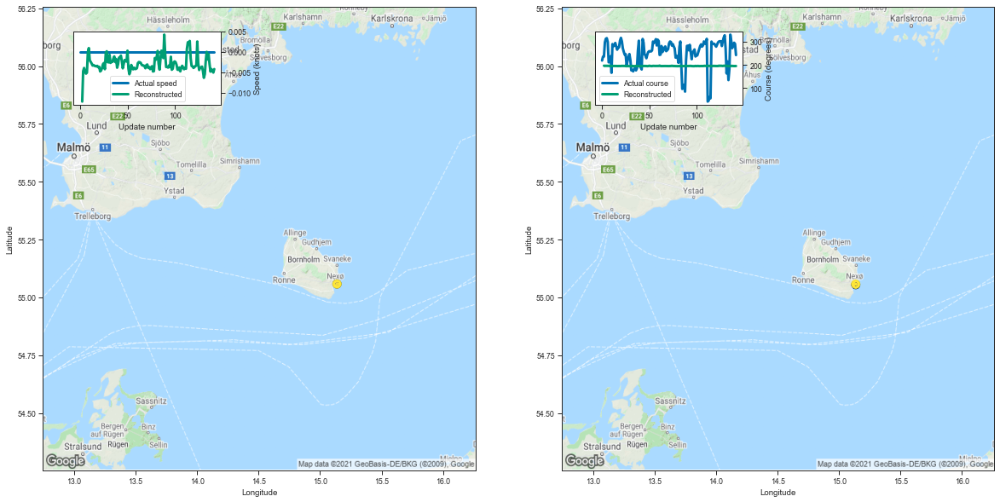

[-0.012173652648925781, -0.0047168731689453125, -0.003945827484130859, -0.004881143569946289]


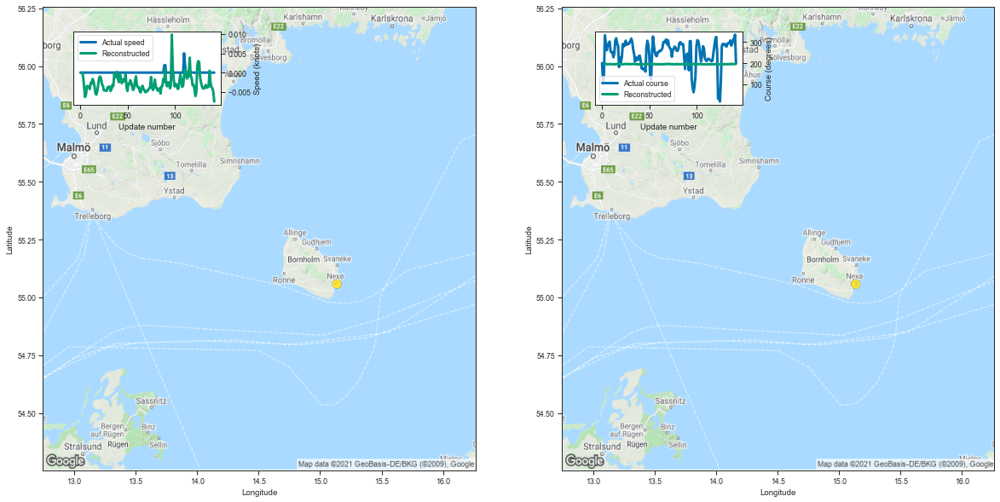

[1.1920928955078125e-06, -0.0010538101196289062, -0.0035653114318847656, -0.006327629089355469]


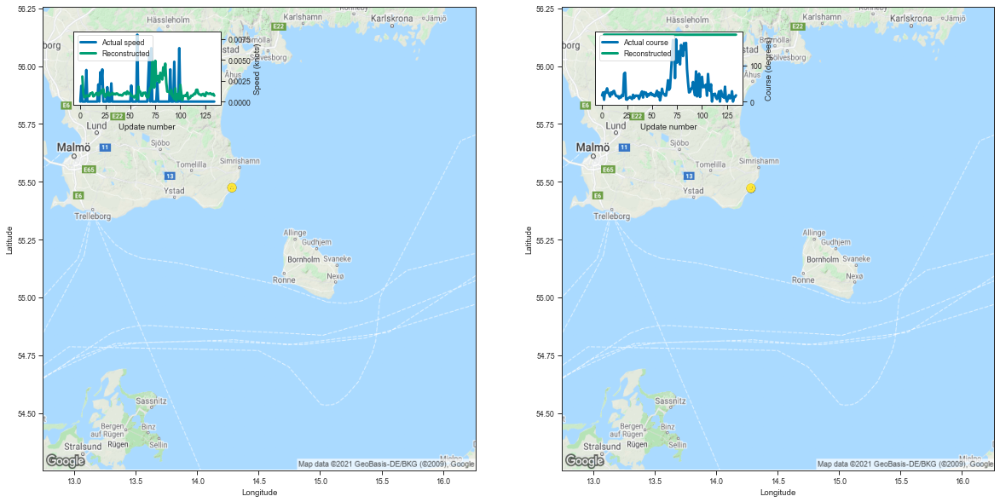

[0.0029981136322021484, 0.000946044921875, 0.0005261898040771484, 0.0005328655242919922]


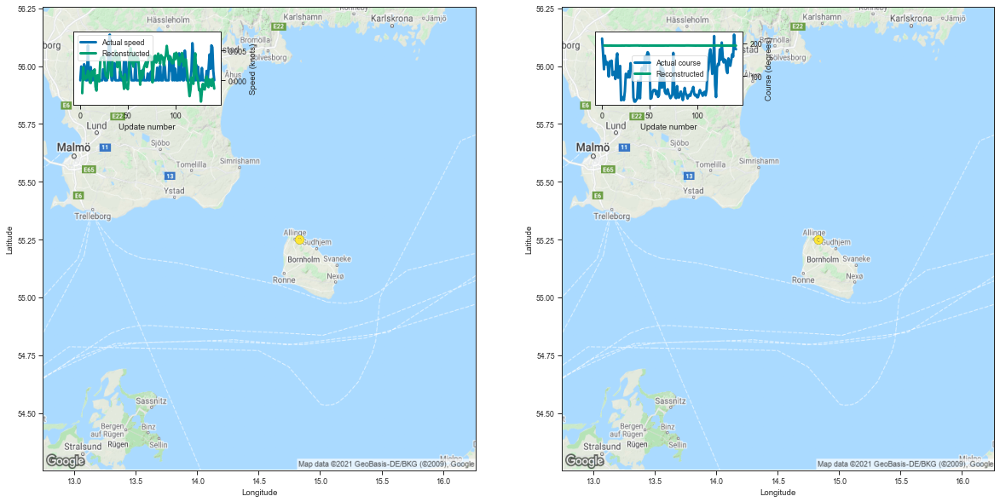

[-0.0021643638610839844, 0.0021903514862060547, 0.00011134147644042969, 0.0007383823394775391]


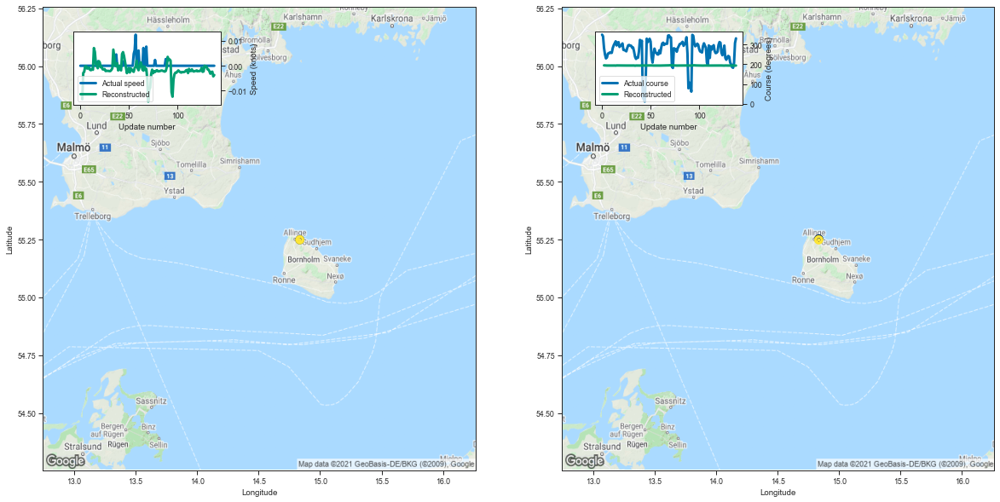

[-0.013433456420898438, -0.0028879642486572266, -0.002408742904663086, -0.00024509429931640625]


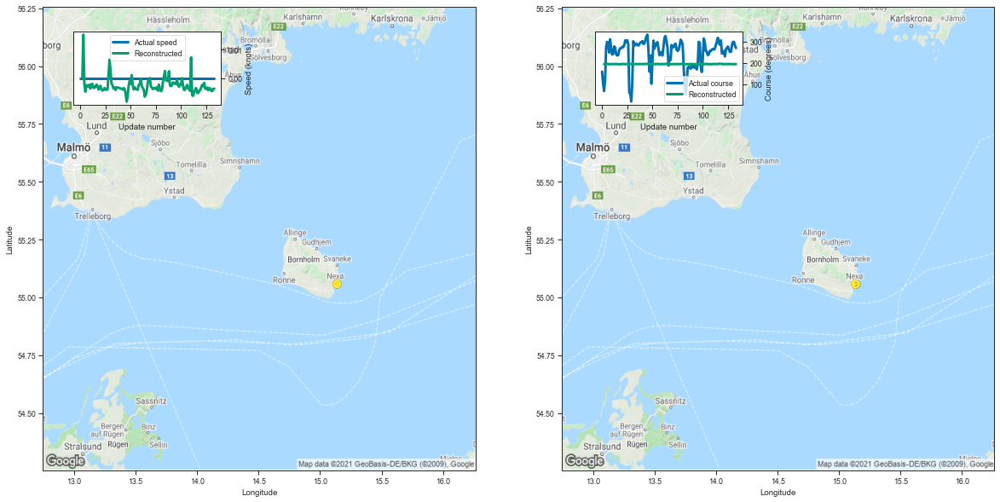

[-0.0001087188720703125, 0.015356898307800293, -0.002062082290649414, -0.0047605037689208984]


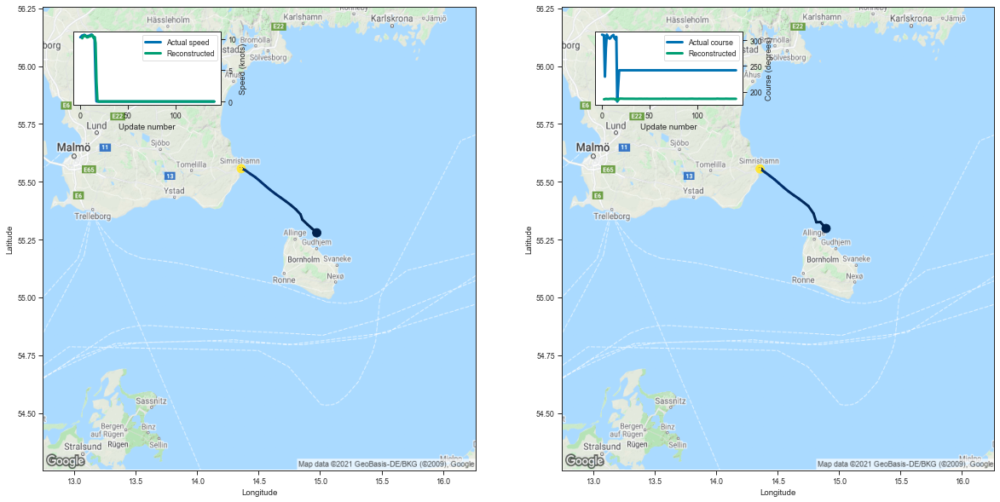

[10.104286193847656, 10.428390502929688, 10.453607559204102, 10.57651138305664]


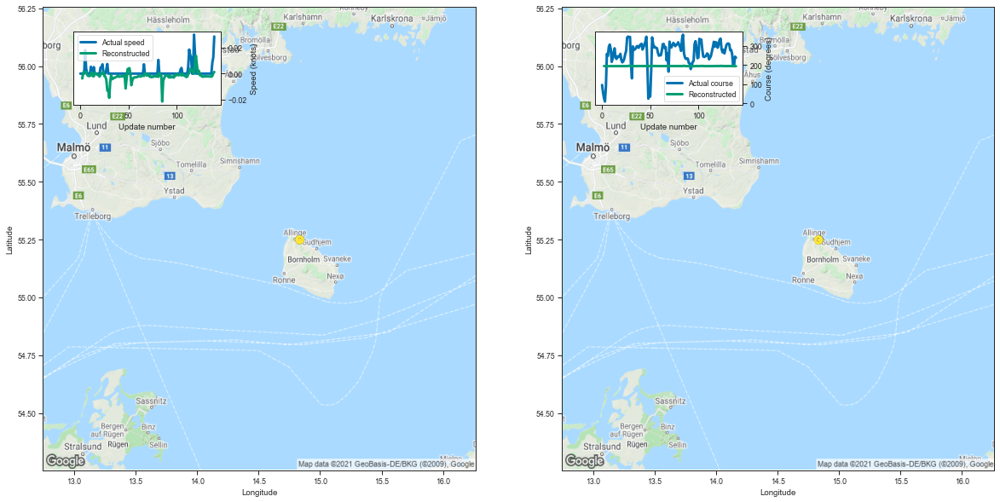

[-0.003750324249267578, 0.0007083415985107422, 0.0013251304626464844, 0.0008978843688964844]


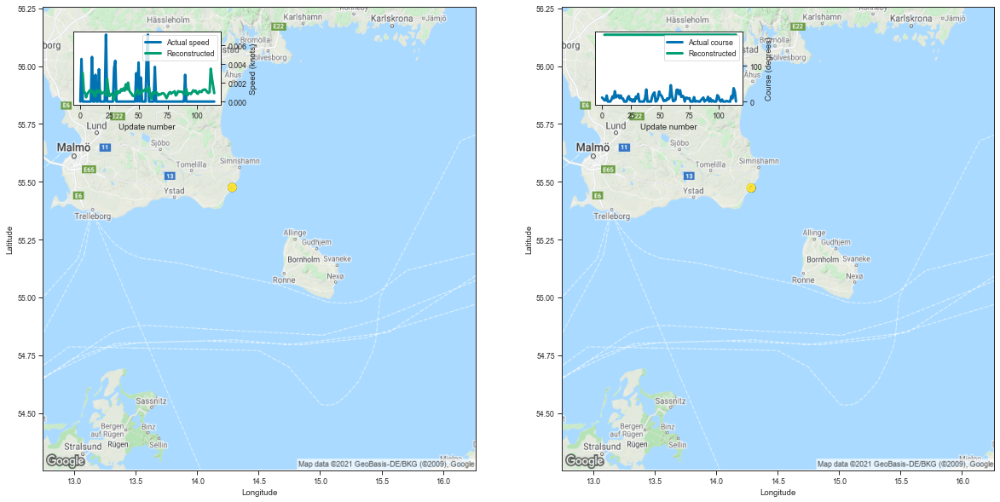

[0.0030477046966552734, 0.0011491775512695312, 0.0009047985076904297, 0.0004527568817138672]


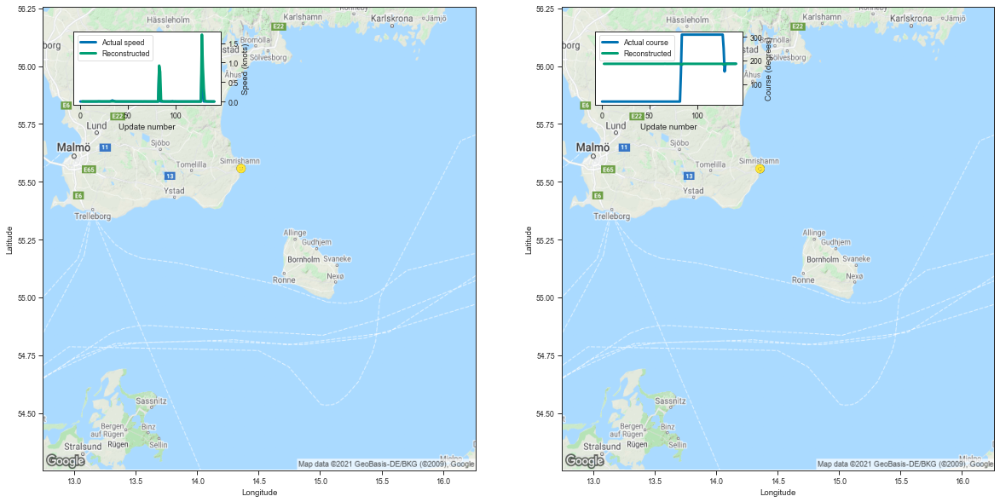

[0.0012333393096923828, 0.0022857189178466797, 0.0004000663757324219, -9.131431579589844e-05]


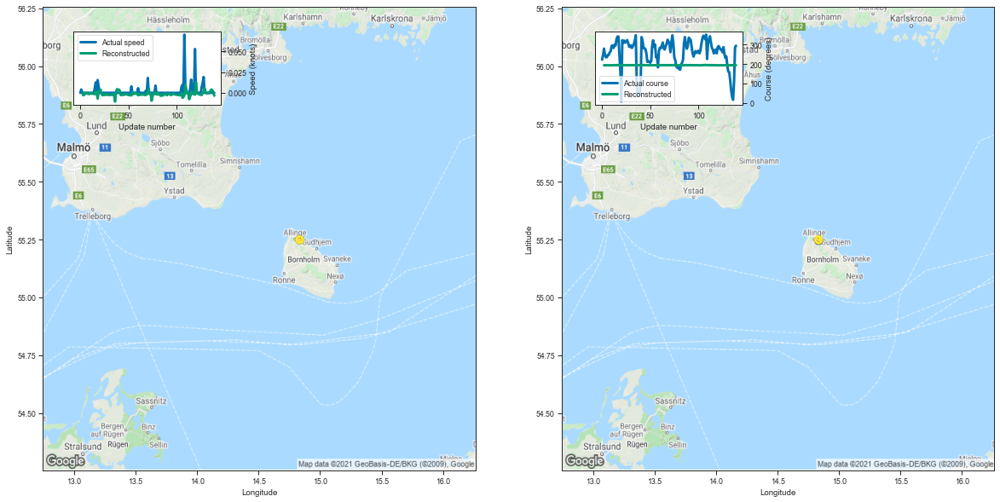

[-0.00010728836059570312, -0.0029320716857910156, -0.002424478530883789, -0.0003991127014160156]


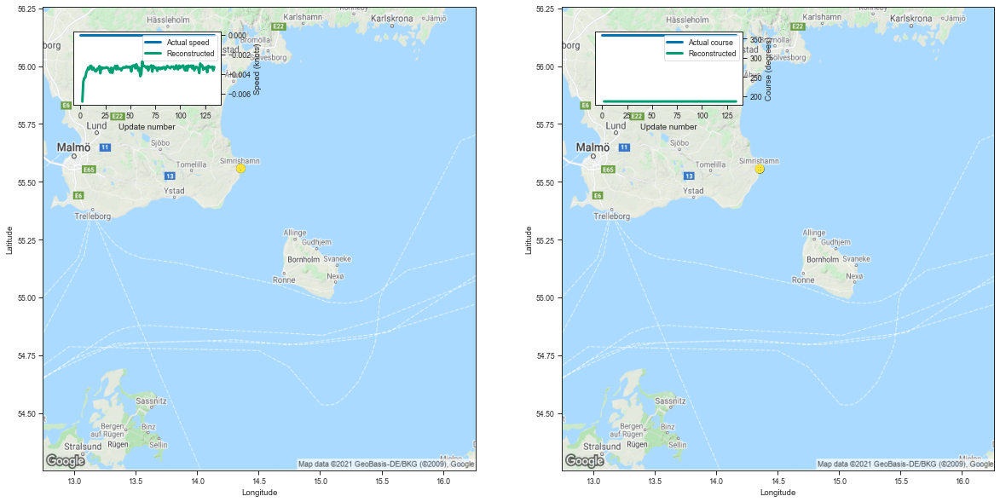

[-0.0068285465240478516, -0.004797458648681641, -0.004425525665283203, -0.004371166229248047]


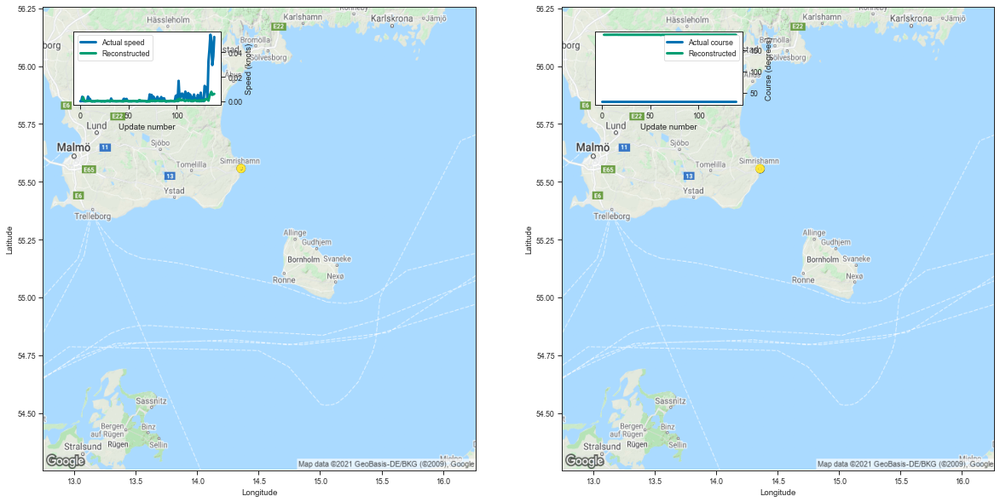

[0.0009734630584716797, 0.003190279006958008, 0.0006356239318847656, -4.6253204345703125e-05]


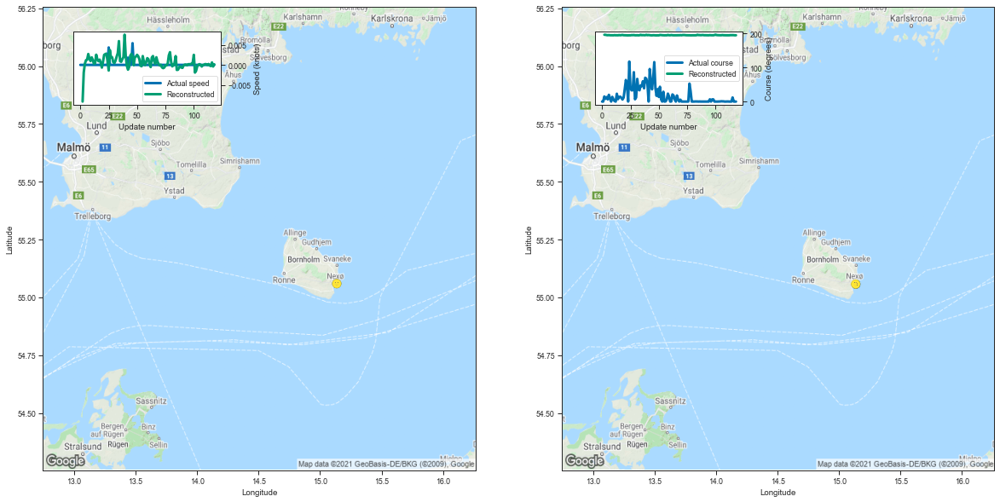

[-0.009141206741333008, -0.0018990039825439453, 0.0003046989440917969, 0.001165151596069336]


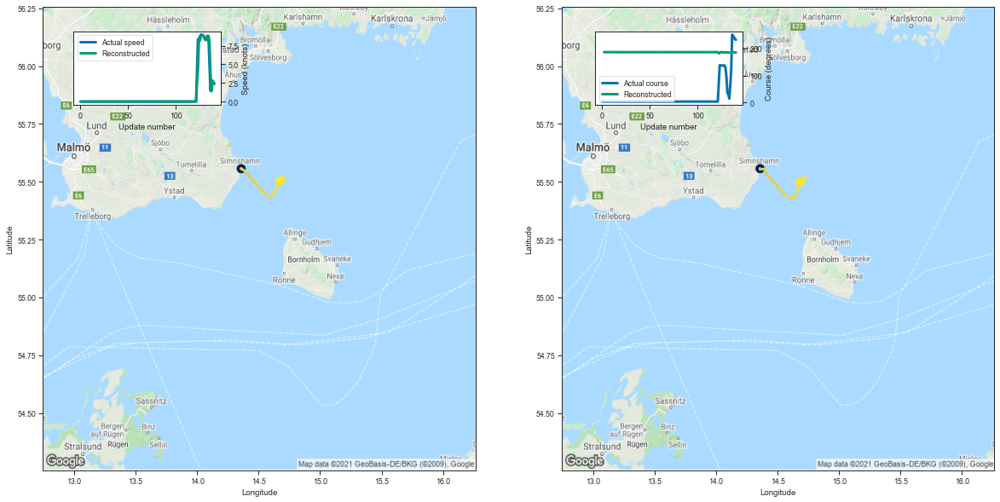

[0.00348663330078125, 0.004603147506713867, 0.0014917850494384766, 0.0006234645843505859]


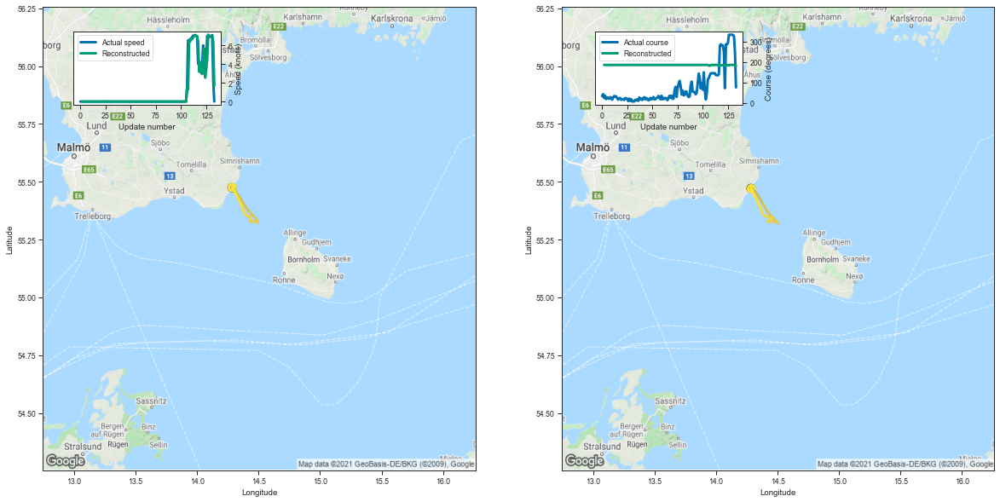

[0.0015964508056640625, 0.0005800724029541016, 0.0007359981536865234, 0.0006630420684814453]


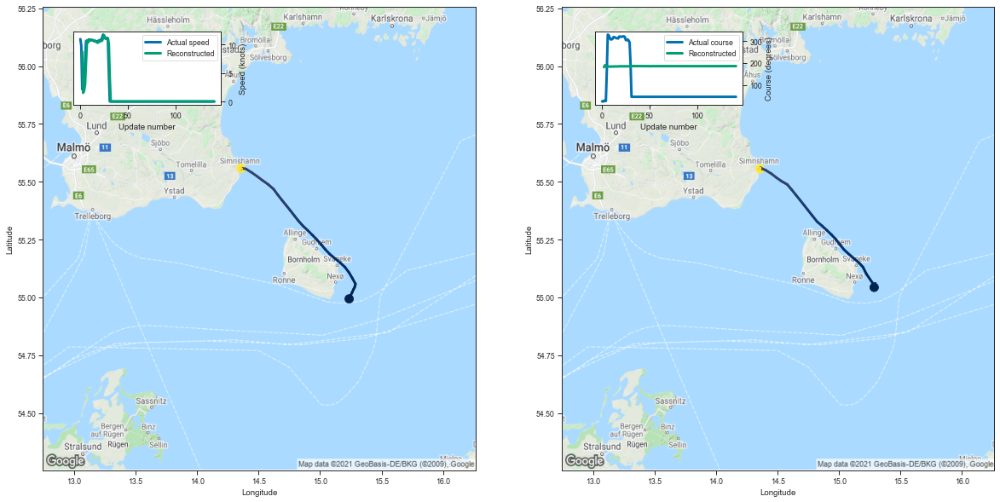

[8.764892578125, 1.5189054012298584, 1.938313603401184, 2.995849847793579]


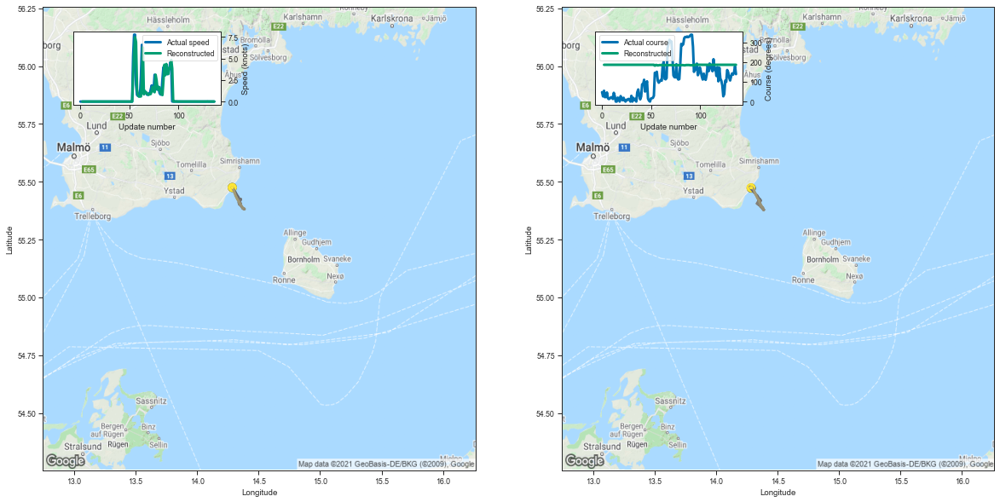

[0.0016934871673583984, -8.988380432128906e-05, 0.0003018379211425781, 0.0007188320159912109]


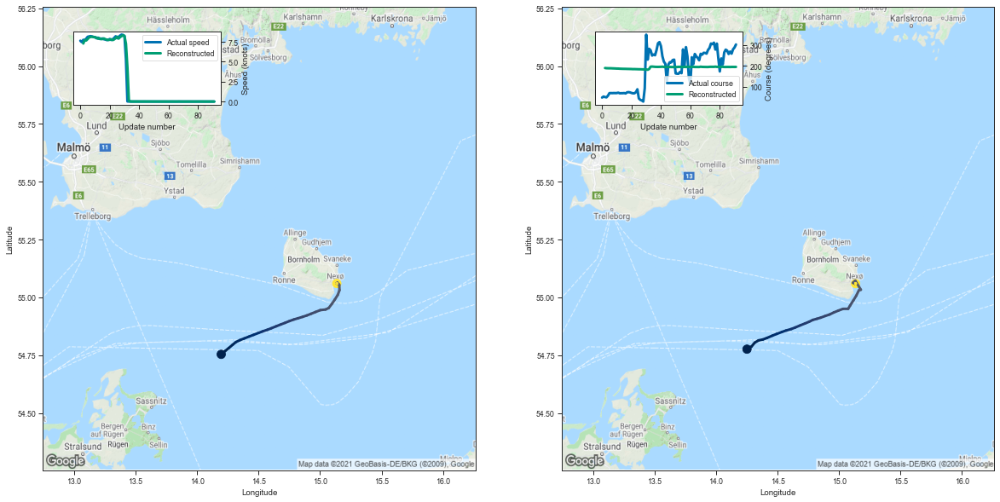

[7.2909440994262695, 7.7420501708984375, 7.67533540725708, 7.862715721130371]


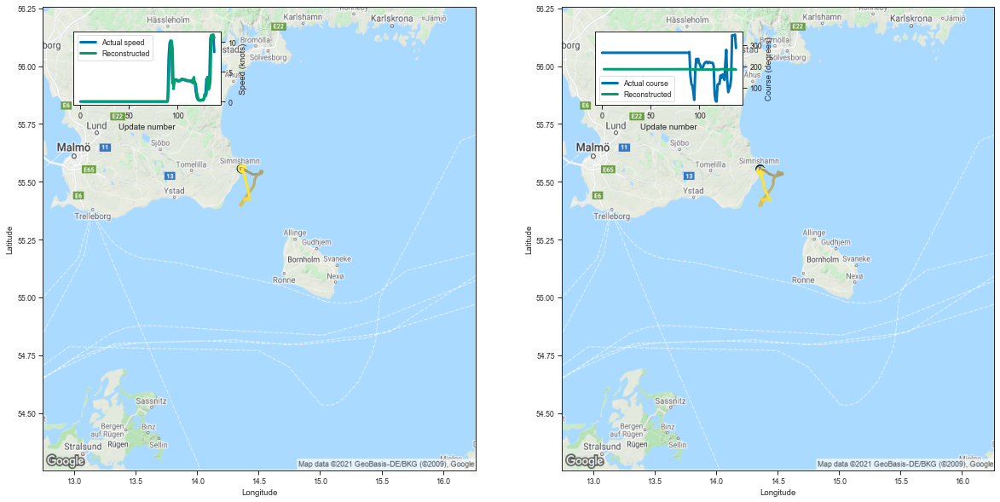

[-0.002167940139770508, -0.0014467239379882812, -0.0025167465209960938, -0.0020666122436523438]


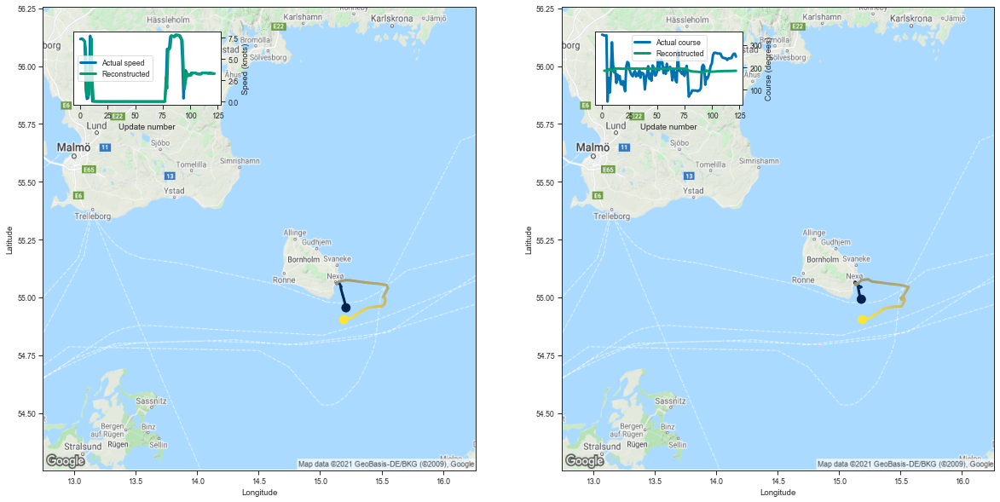

[7.258542537689209, 7.206281661987305, 7.087983131408691, 6.079854488372803]


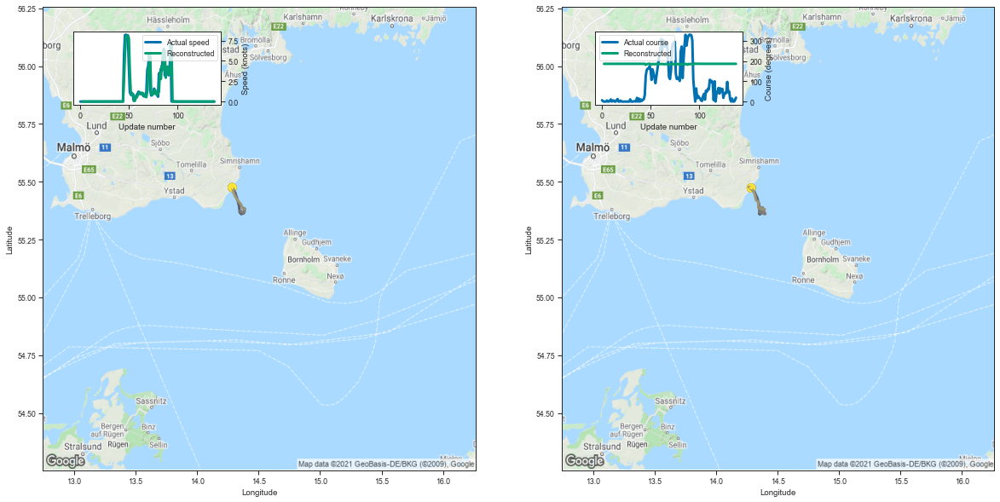

[0.0026671886444091797, 0.0017158985137939453, 0.0013041496276855469, 0.0008900165557861328]


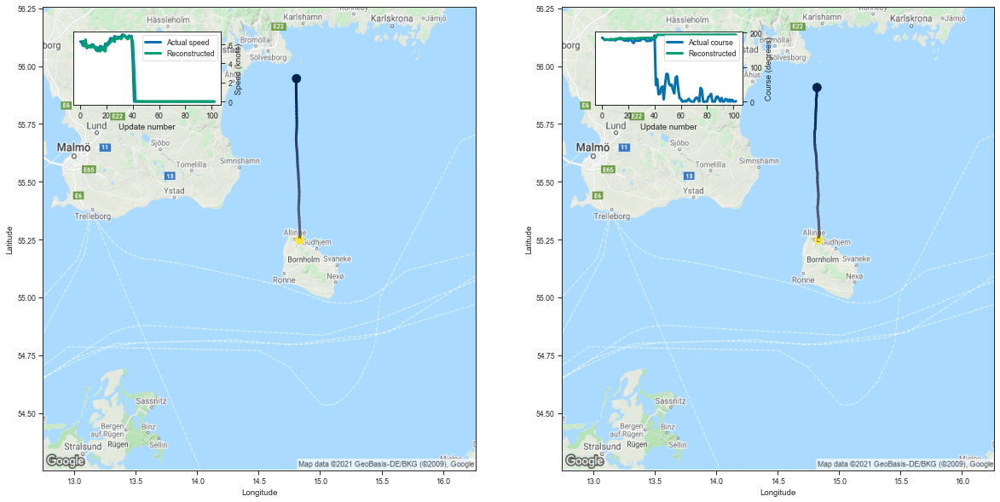

[6.3379340171813965, 5.8106608390808105, 6.502464771270752, 5.594367980957031]


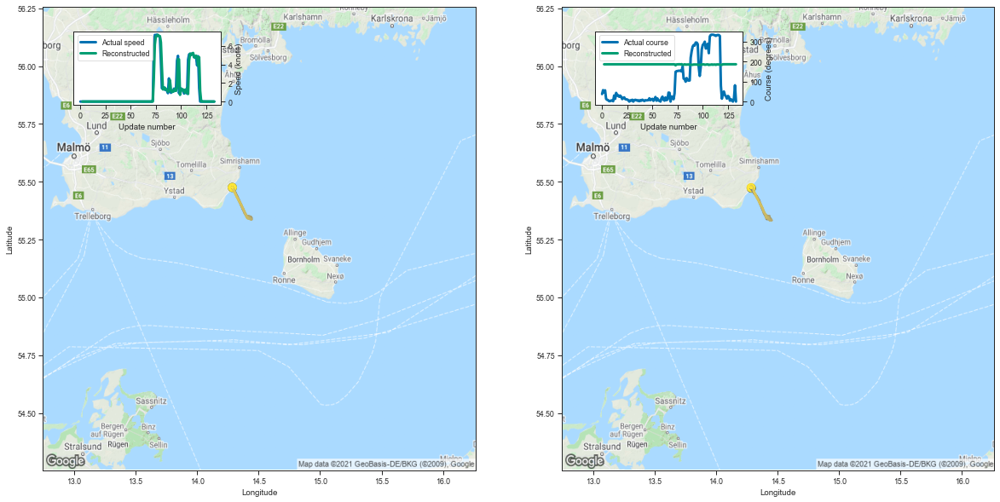

[0.001129150390625, 0.0004379749298095703, 0.0004189014434814453, 0.0005178451538085938]


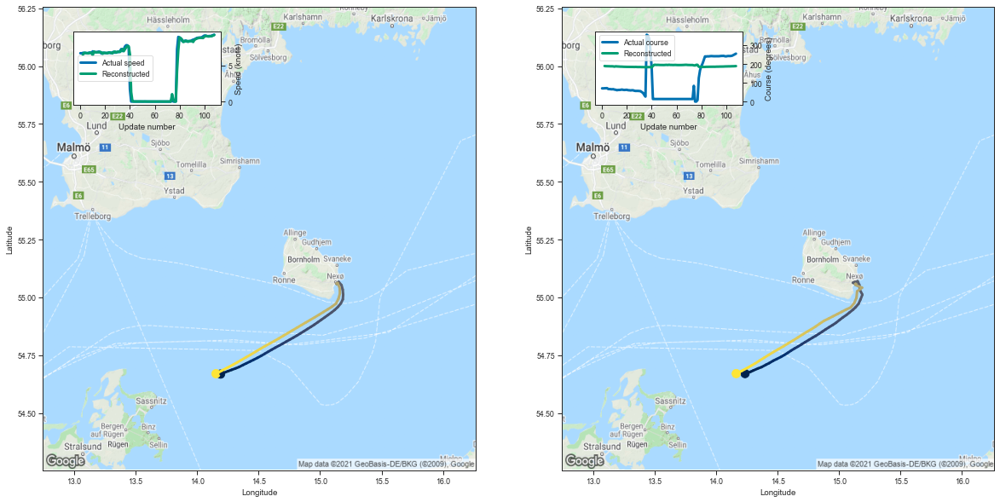

[6.492254257202148, 6.768308162689209, 6.766207218170166, 6.741918087005615]


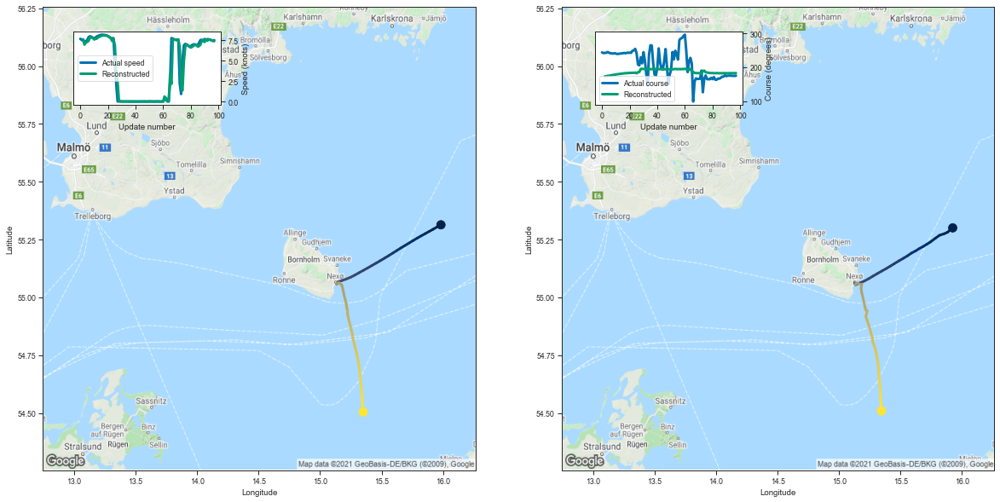

[7.6156415939331055, 6.947762489318848, 7.22108793258667, 7.268416404724121]


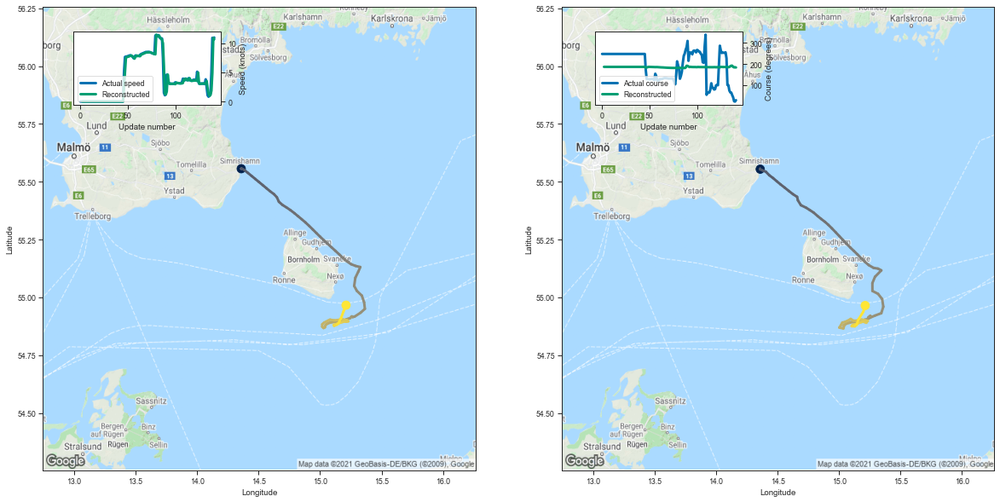

[-0.0030205249786376953, -0.0009493827819824219, -0.002328634262084961, -0.001725912094116211]


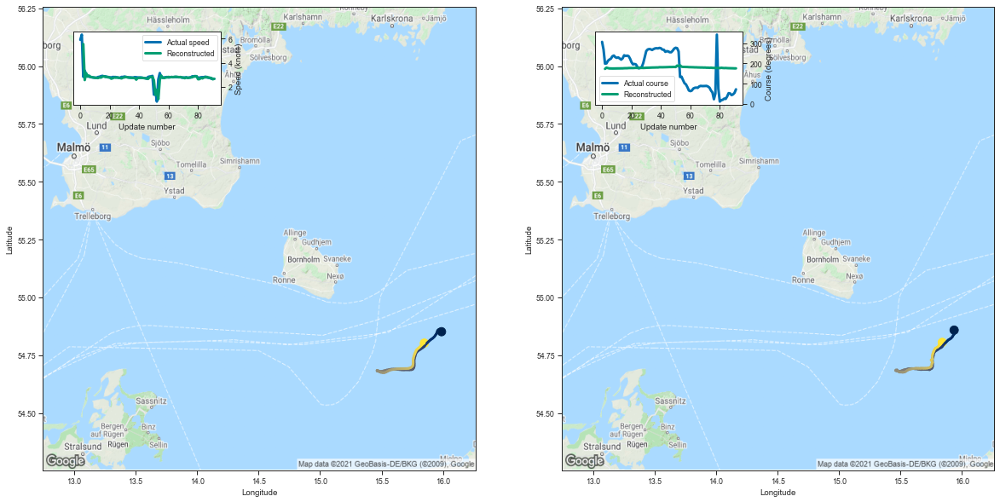

[5.549784183502197, 2.56877064704895, 3.1314547061920166, 2.8530125617980957]


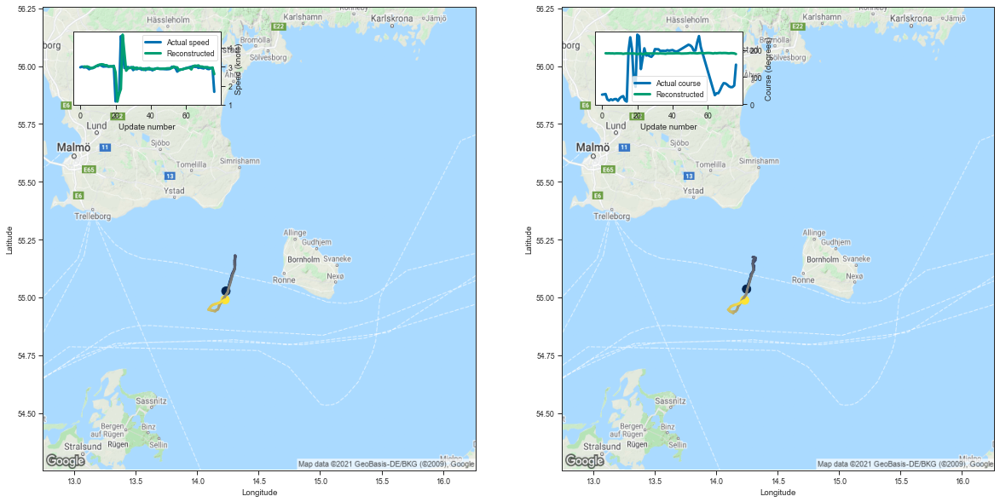

[3.0086679458618164, 3.0007944107055664, 3.0100395679473877, 2.974971055984497]


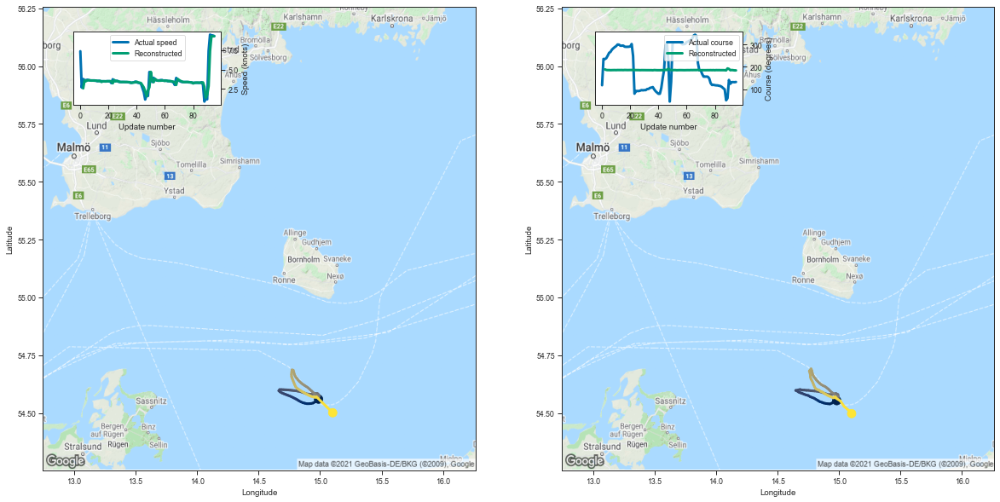

[2.577972888946533, 3.597780704498291, 3.508157253265381, 3.606614589691162]


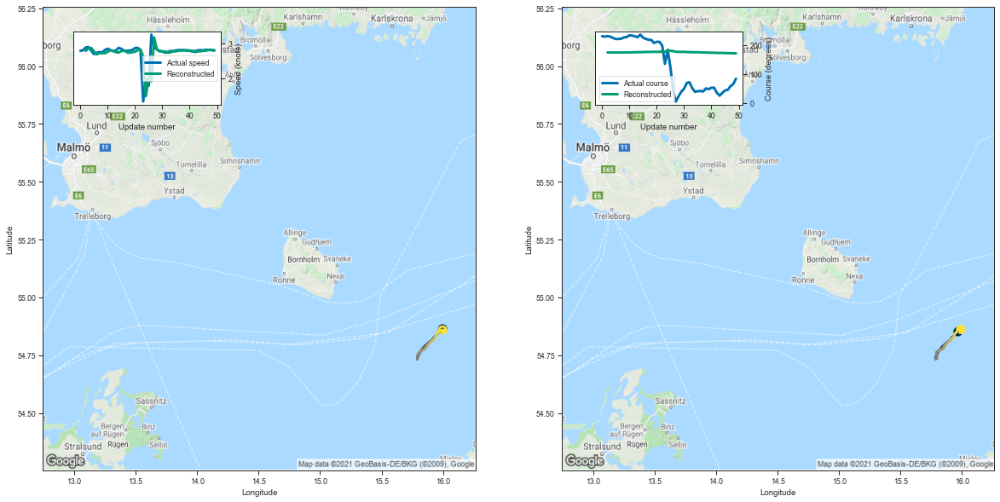

[2.7825818061828613, 2.8623337745666504, 2.8655354976654053, 2.7672080993652344]


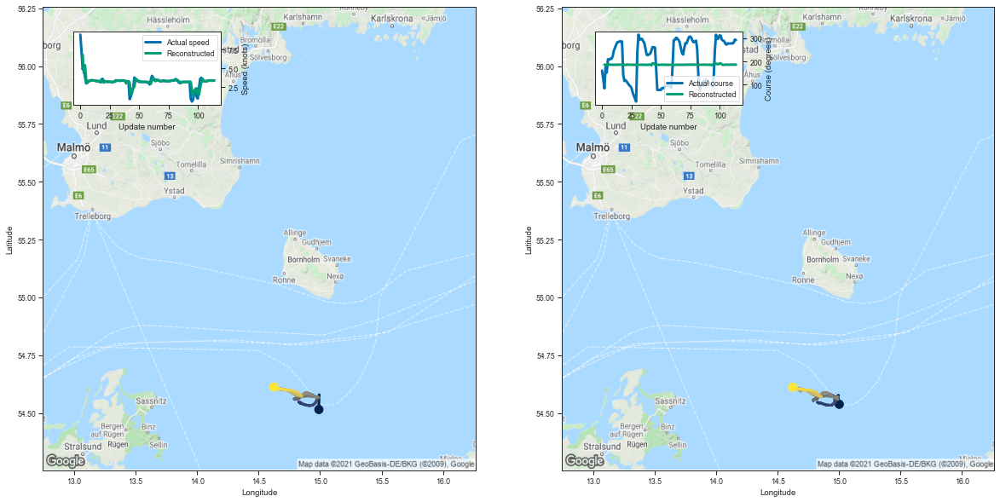

[6.8293843269348145, 4.407245635986328, 5.411983489990234, 3.446157693862915]


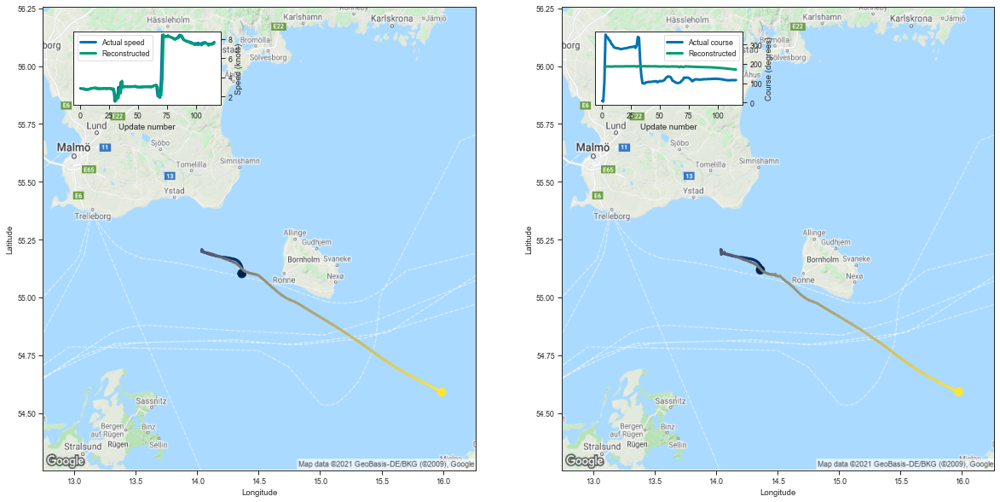

[2.835333824157715, 2.827608585357666, 2.782395362854004, 2.7552642822265625]


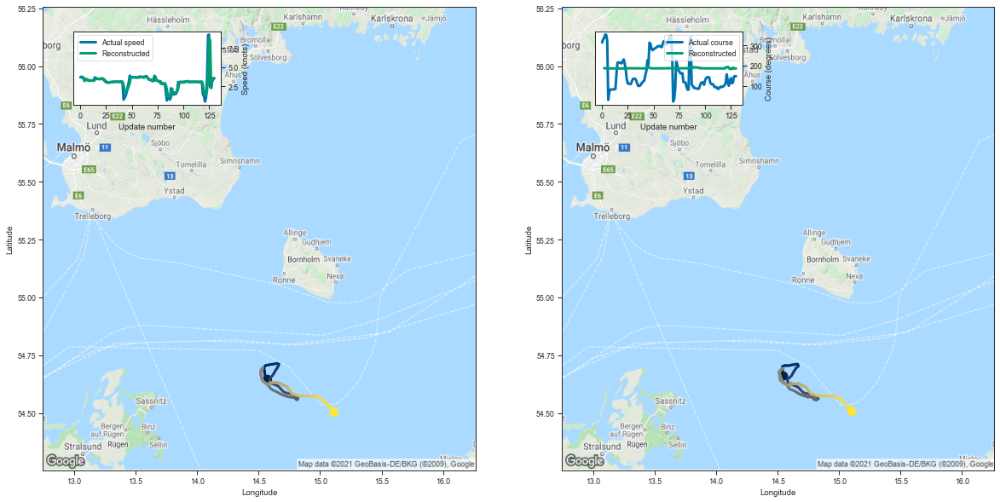

[3.6084065437316895, 3.662144422531128, 3.2076568603515625, 3.293234348297119]


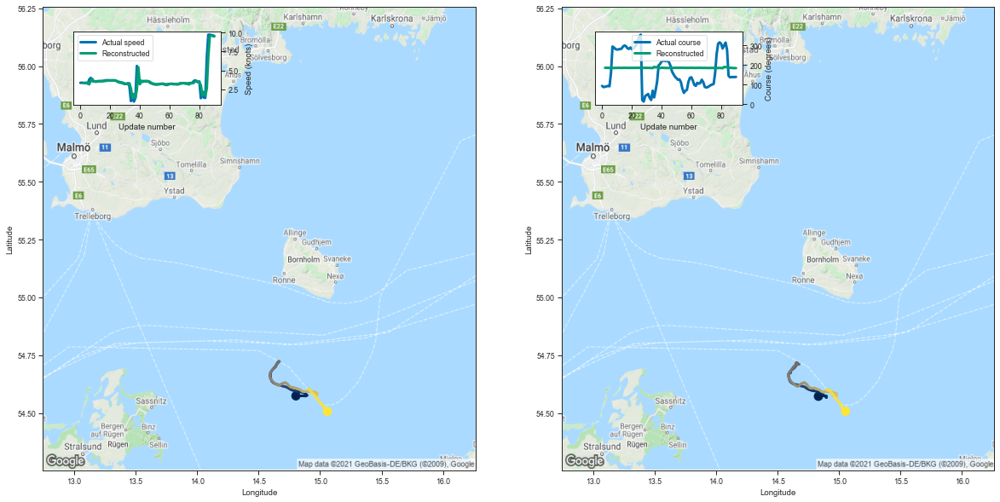

[3.345076084136963, 3.3686981201171875, 3.3487777709960938, 3.3793489933013916]


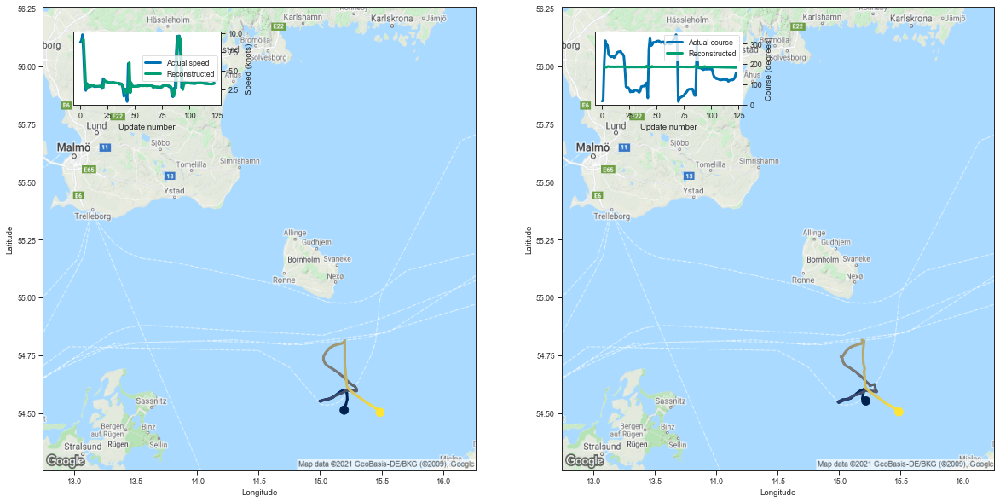

[8.933808326721191, 9.143062591552734, 6.12373685836792, 3.0793232917785645]


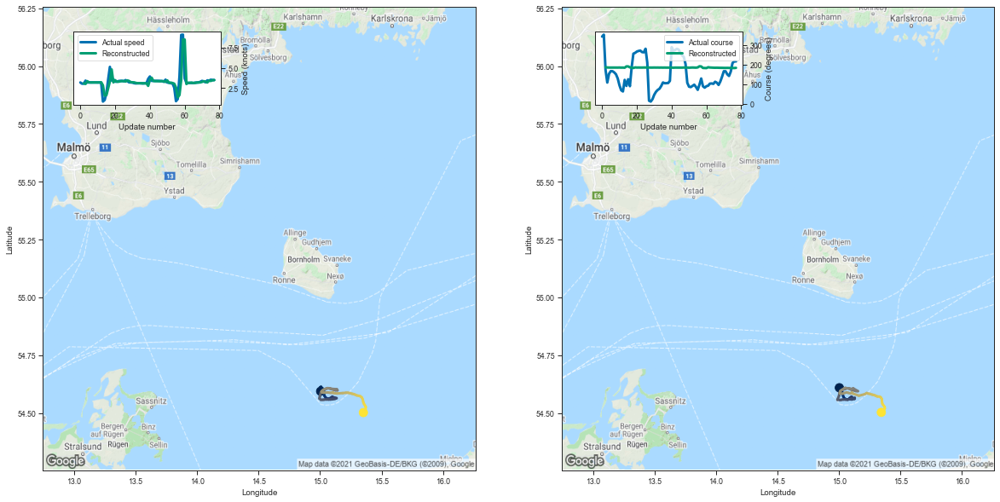

[3.0911765098571777, 3.0170326232910156, 3.3586864471435547, 3.2153749465942383]


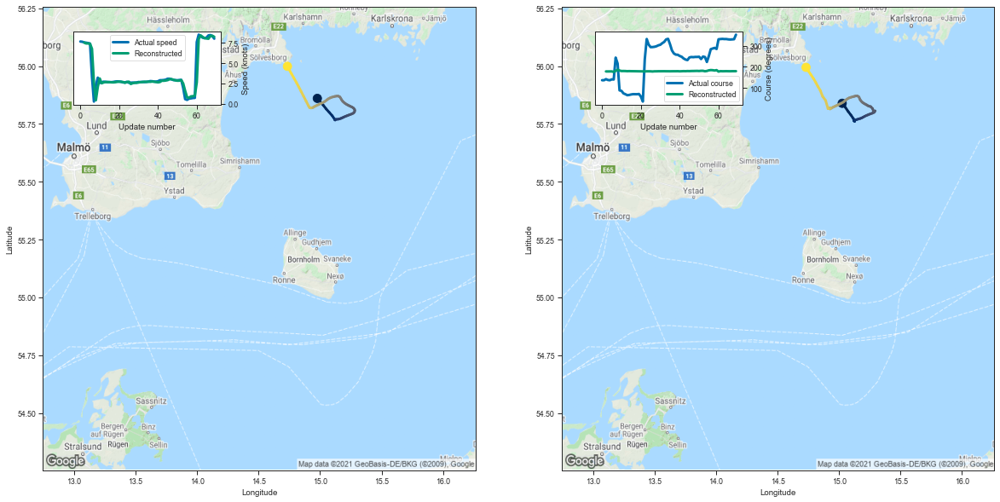

[7.530093193054199, 7.415227890014648, 7.4186882972717285, 7.368211269378662]


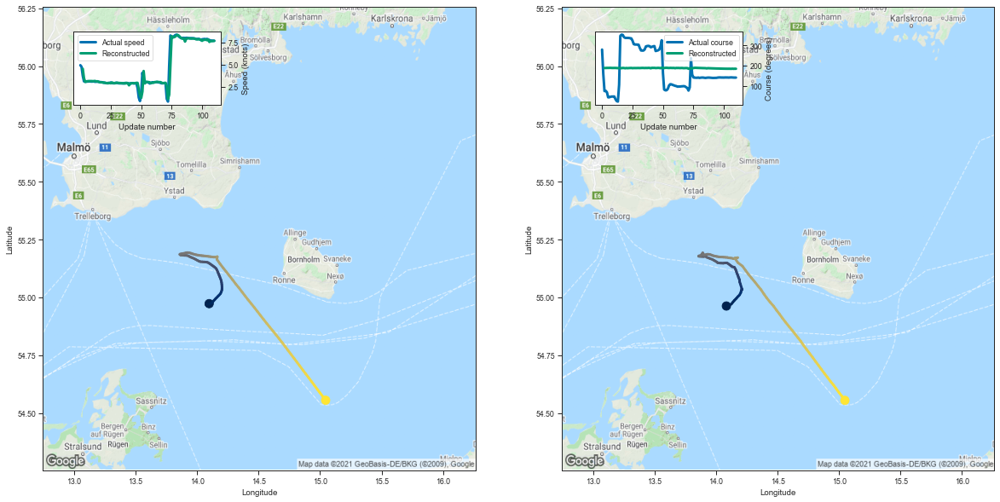

[4.538066864013672, 3.467585563659668, 3.058936595916748, 3.10251522064209]


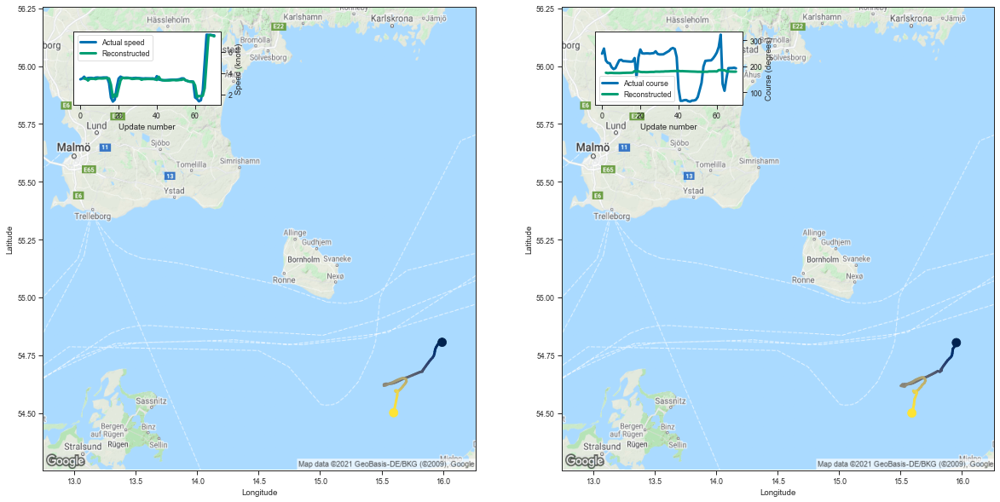

[3.483607053756714, 3.513974189758301, 3.3133115768432617, 3.481048822402954]


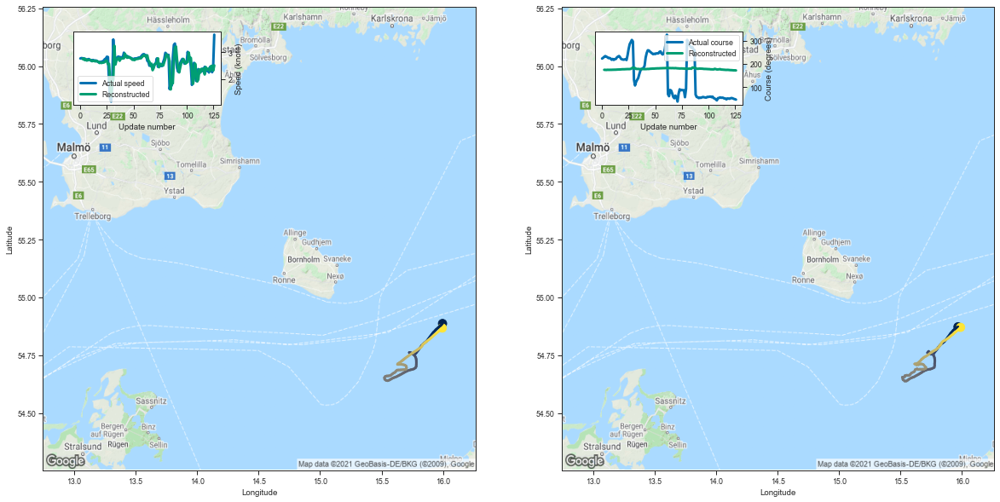

[2.743191957473755, 2.767413377761841, 2.707963466644287, 2.7438552379608154]


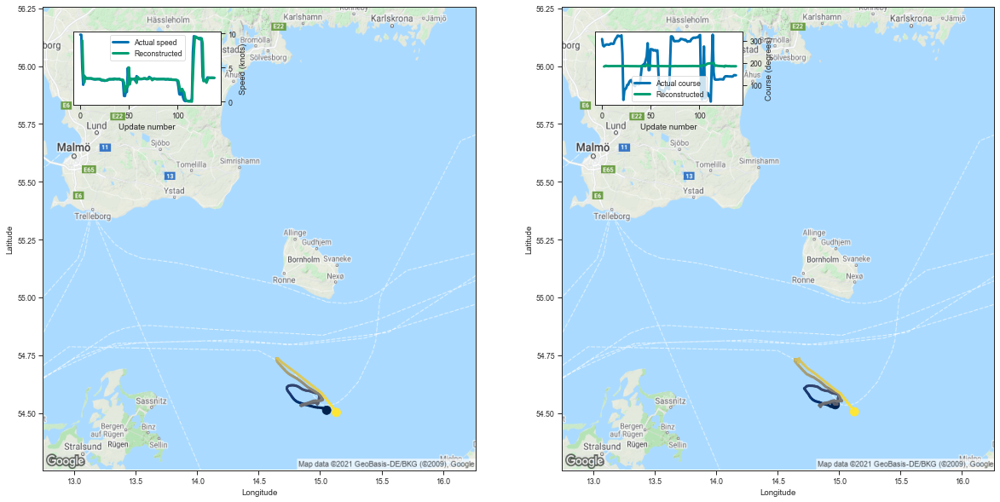

[8.942432403564453, 4.031213760375977, 2.794203042984009, 3.6321816444396973]


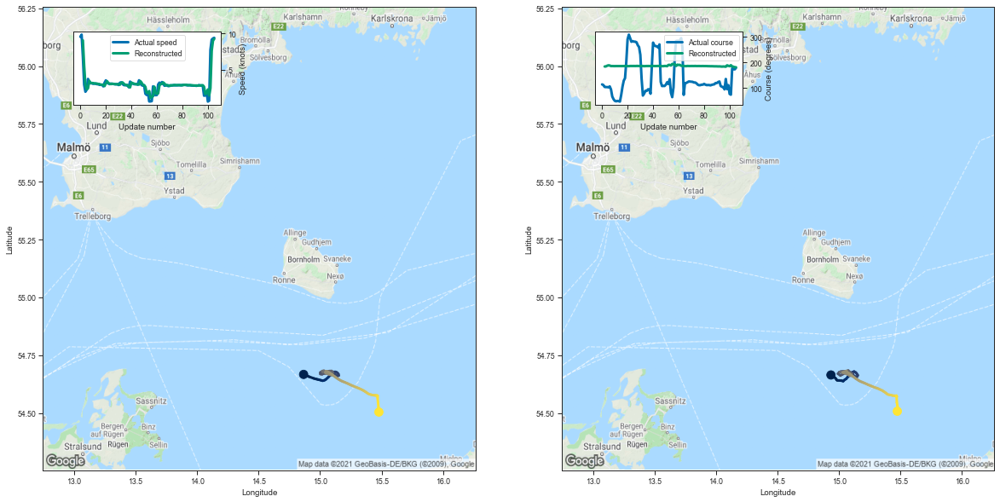

[9.050884246826172, 5.5145745277404785, 2.8101422786712646, 2.252808094024658]


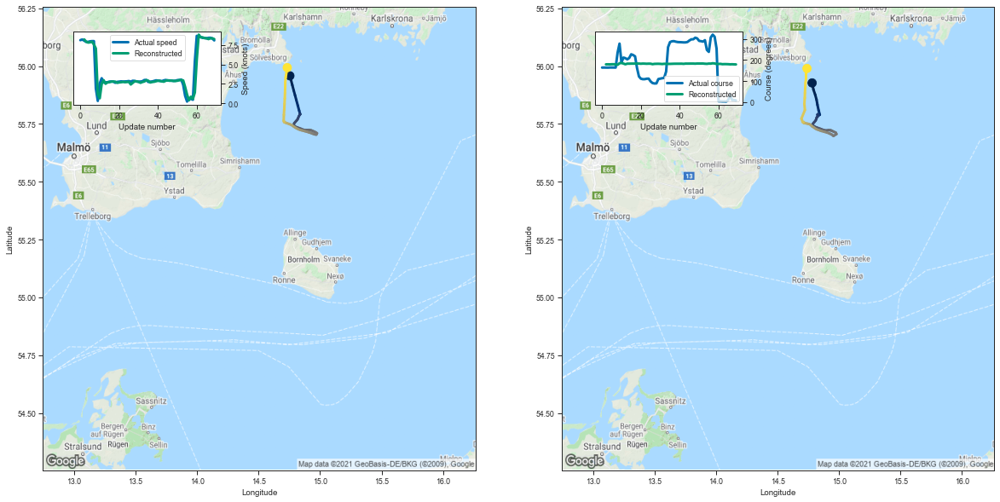

[8.215238571166992, 7.929281234741211, 7.8109965324401855, 7.84138298034668]


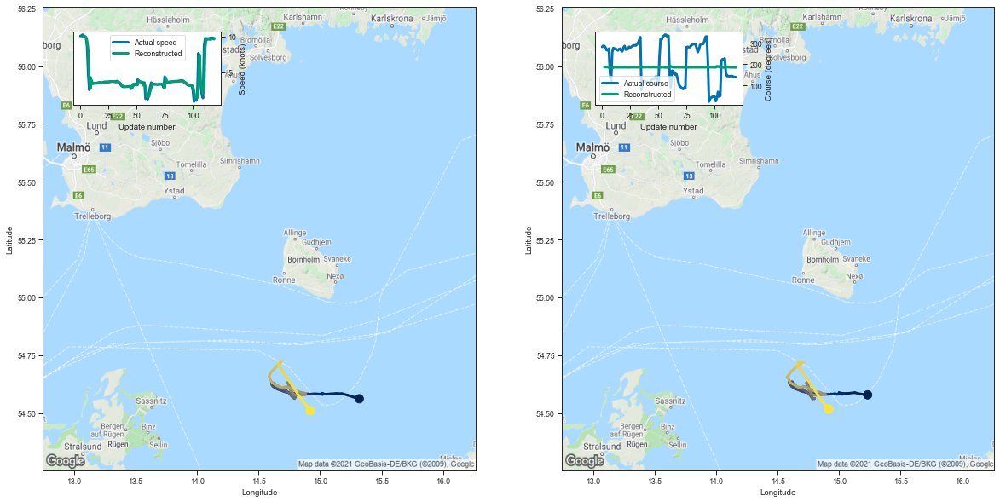

[9.951569557189941, 10.101226806640625, 9.993913650512695, 9.910382270812988]


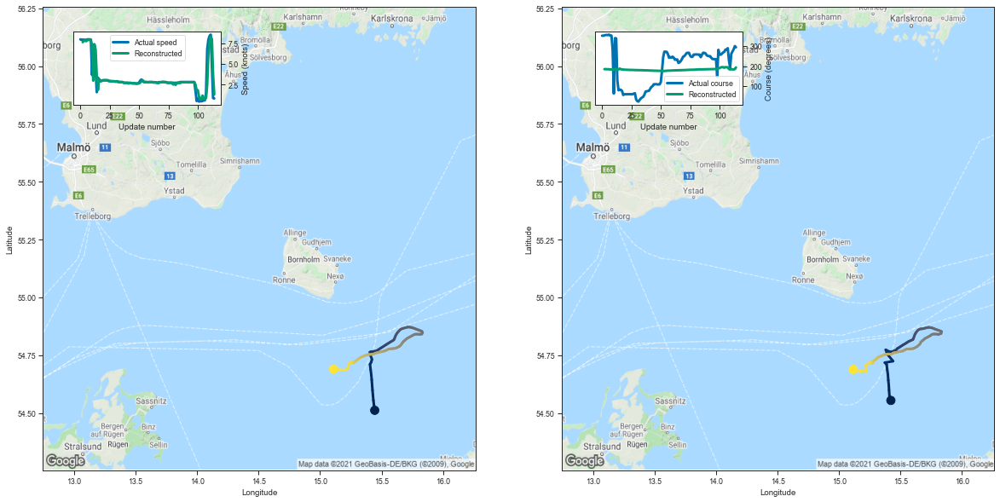

[7.652885913848877, 7.8465471267700195, 7.825566291809082, 7.774393081665039]


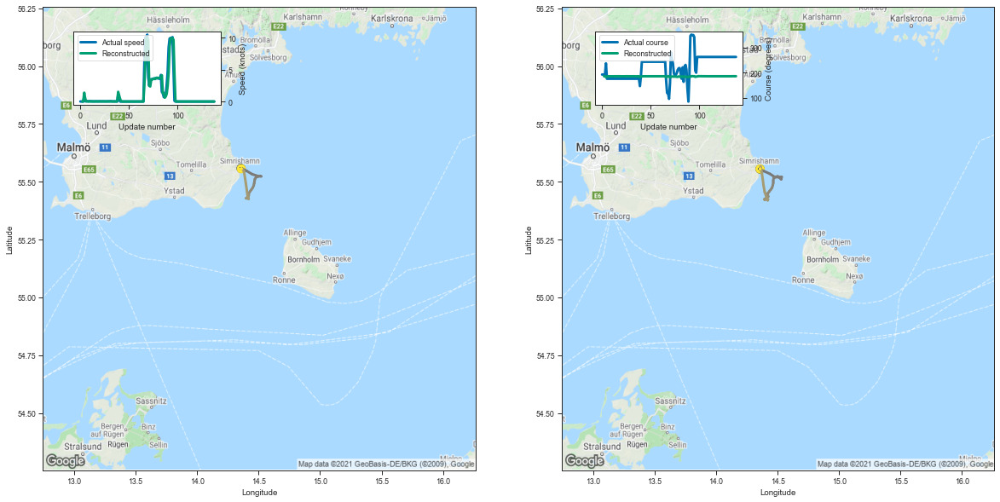

[-0.0006761550903320312, 0.0008401870727539062, 1.387439250946045, 0.5000841617584229]


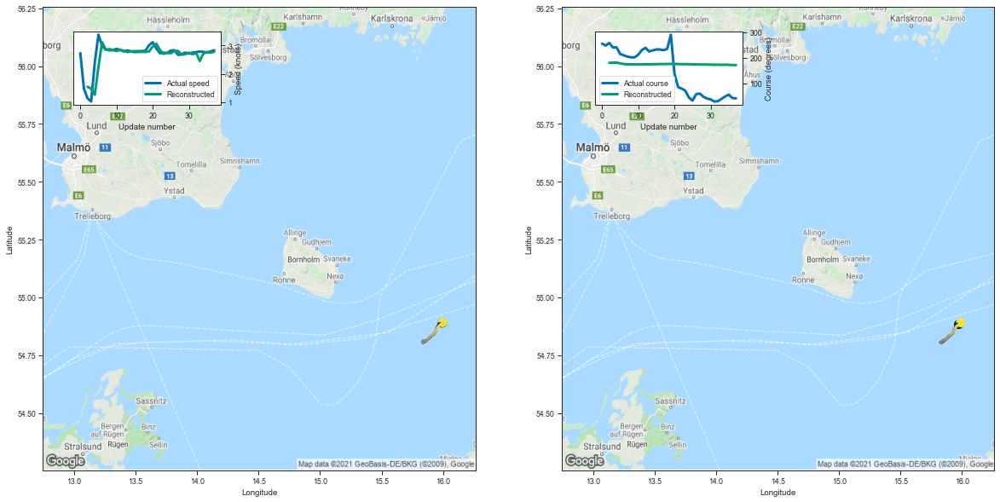

[1.5456980466842651, 1.4718272686004639, 1.2628148794174194, 2.238661527633667]


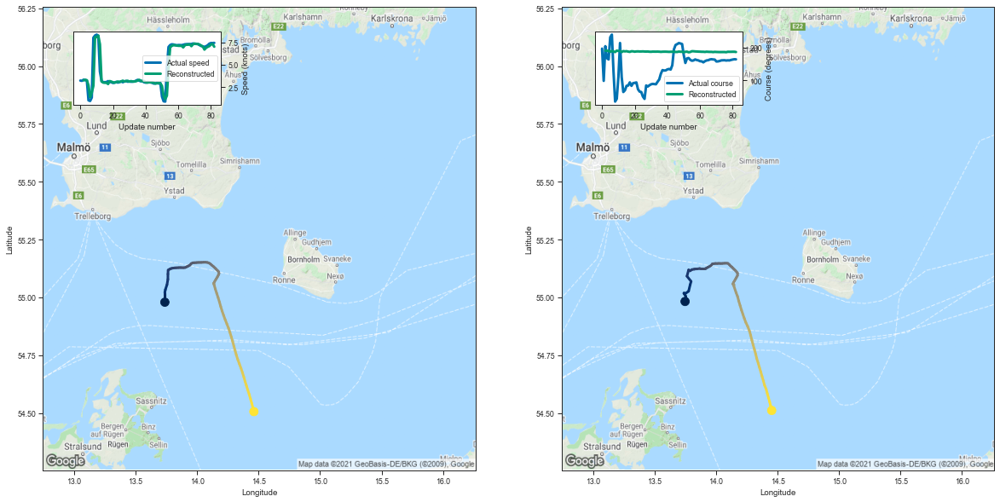

[3.25022554397583, 3.3095102310180664, 3.2603230476379395, 2.683267116546631]


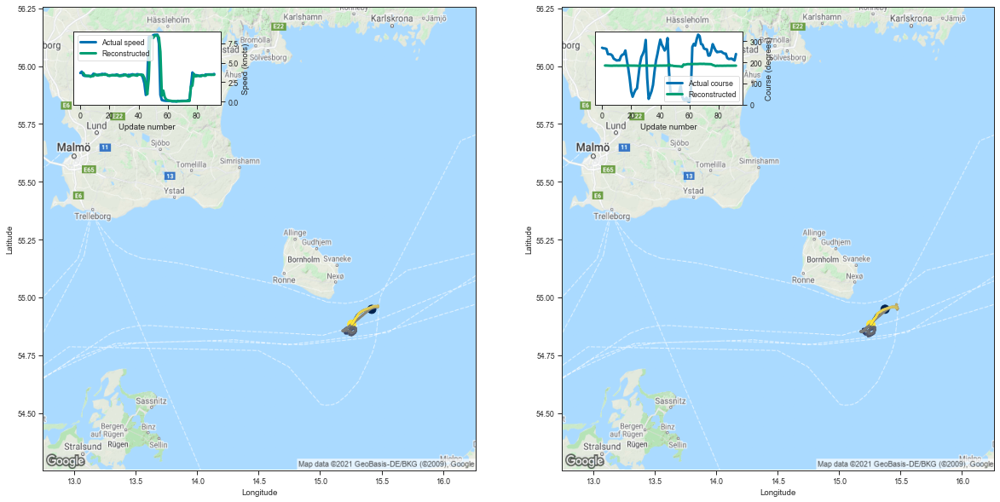

[3.7074618339538574, 3.402888774871826, 3.324915647506714, 3.3237524032592773]


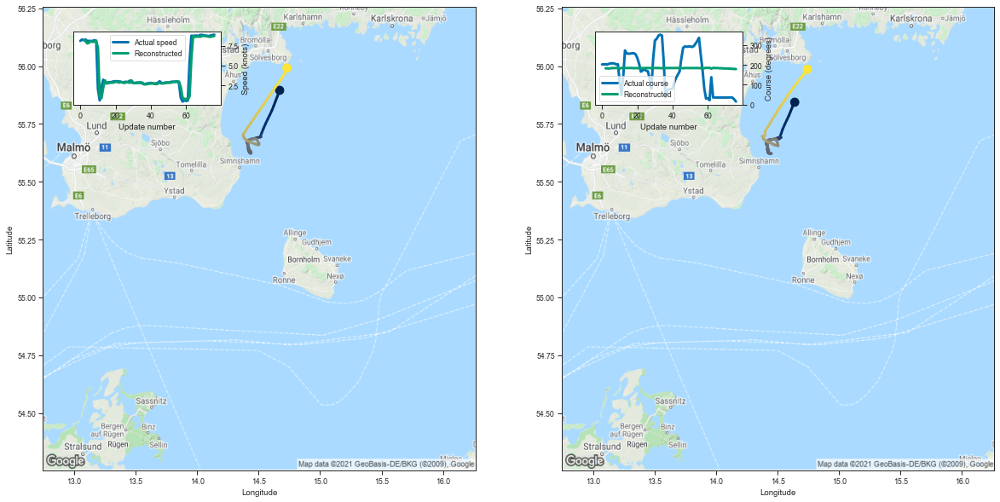

[8.187856674194336, 8.053706169128418, 7.774250507354736, 7.854493618011475]


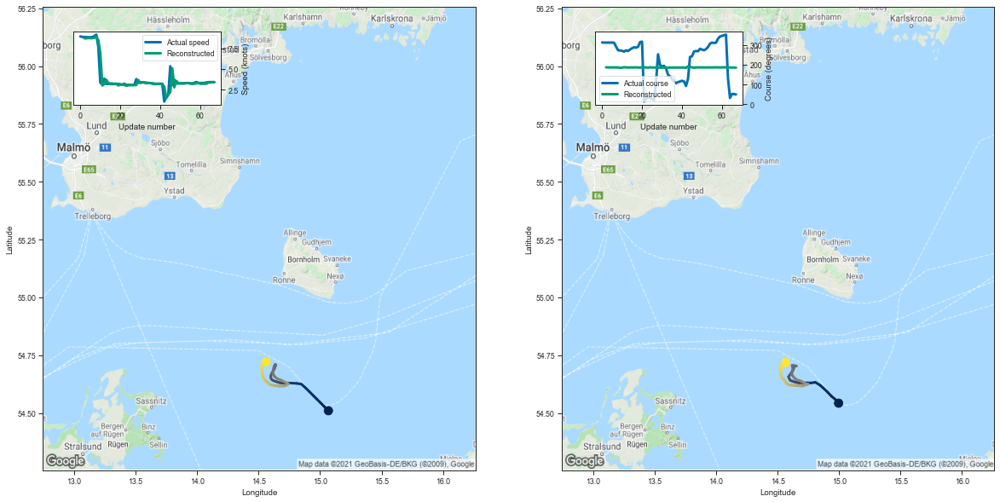

[8.73859691619873, 8.71572494506836, 8.778112411499023, 8.73806381225586]


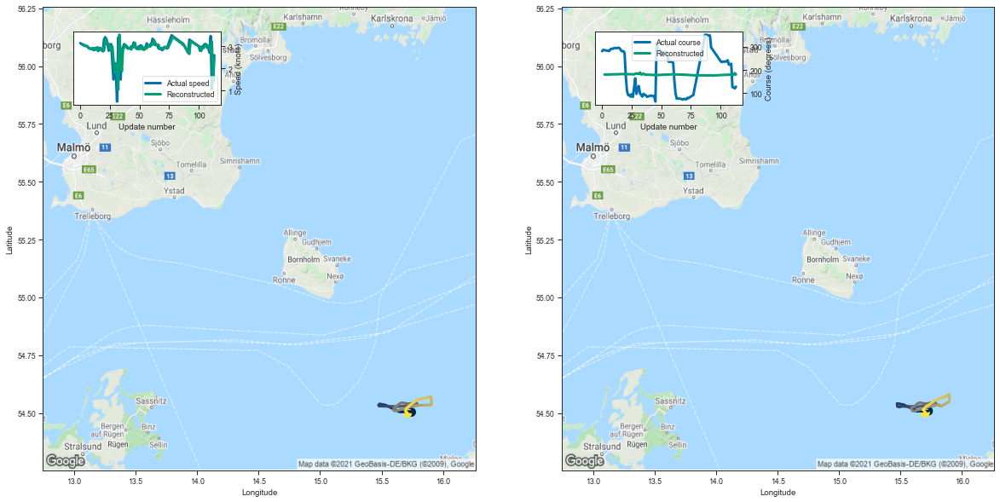

[3.0938332080841064, 3.0253305435180664, 3.0176055431365967, 3.007850408554077]


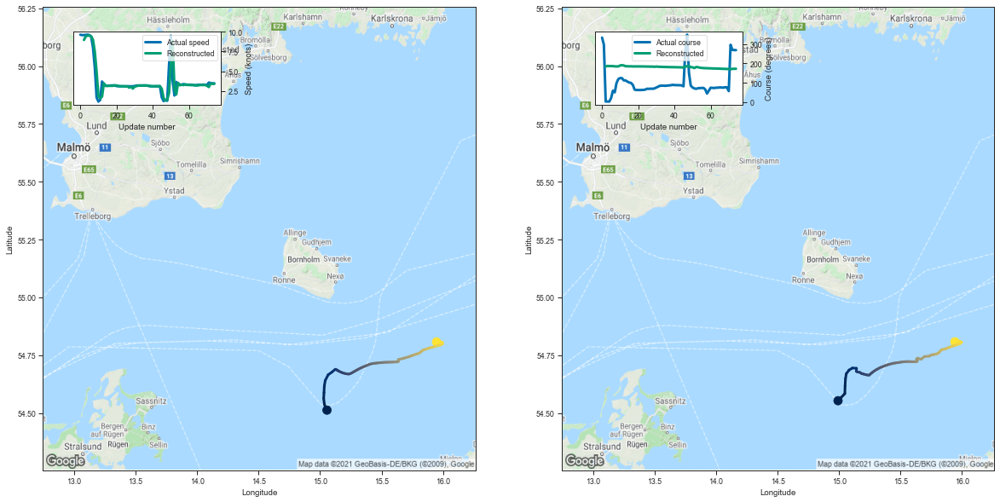

[8.964550971984863, 9.430034637451172, 9.514880180358887, 9.525073051452637]


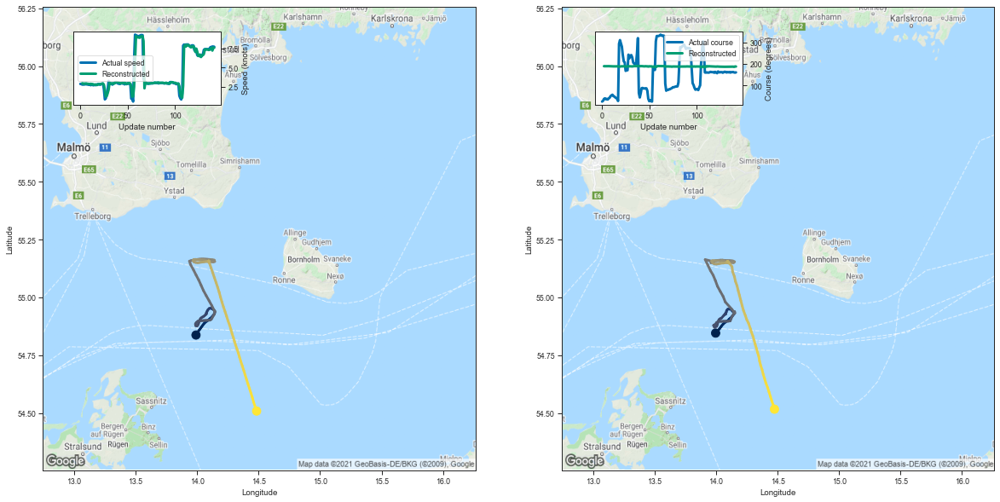

[2.961026191711426, 2.8794753551483154, 2.92950701713562, 2.8851654529571533]


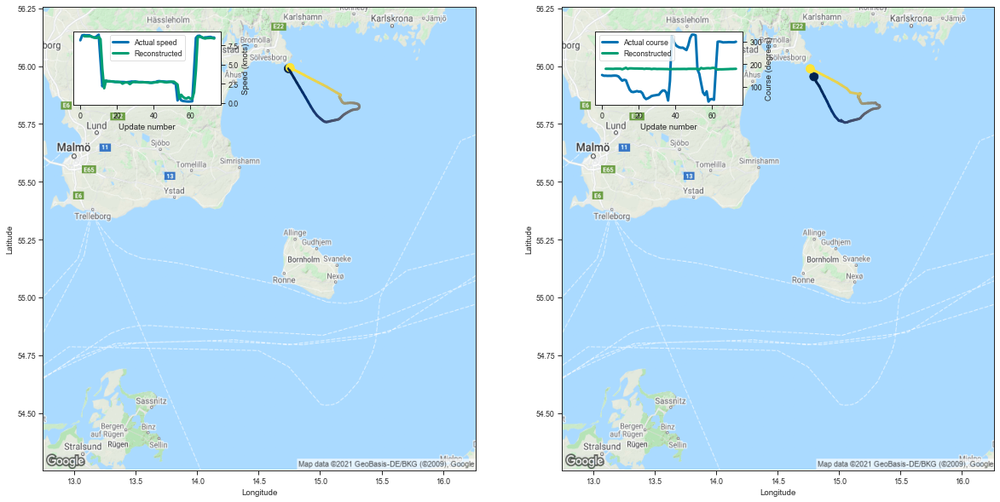

[8.706113815307617, 8.689619064331055, 8.687359809875488, 8.689291954040527]


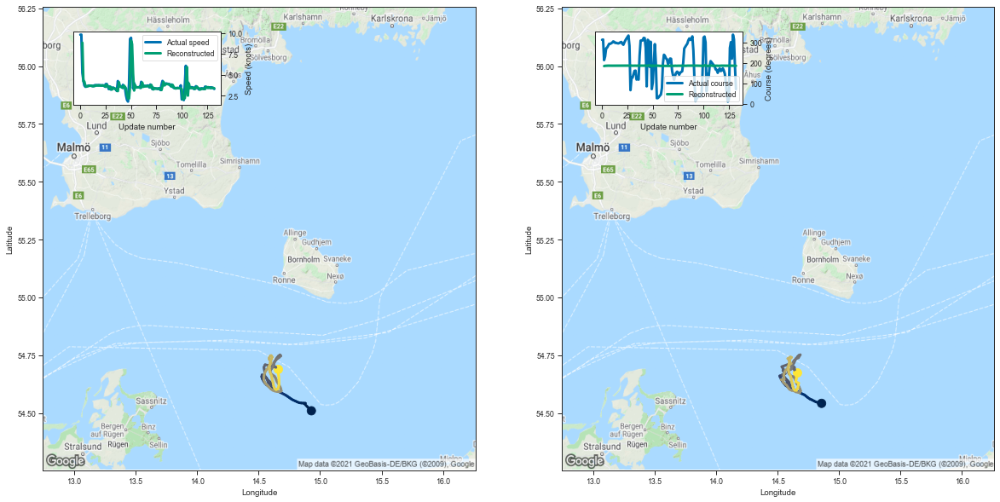

[8.830042839050293, 4.2215576171875, 4.156839370727539, 3.6709091663360596]


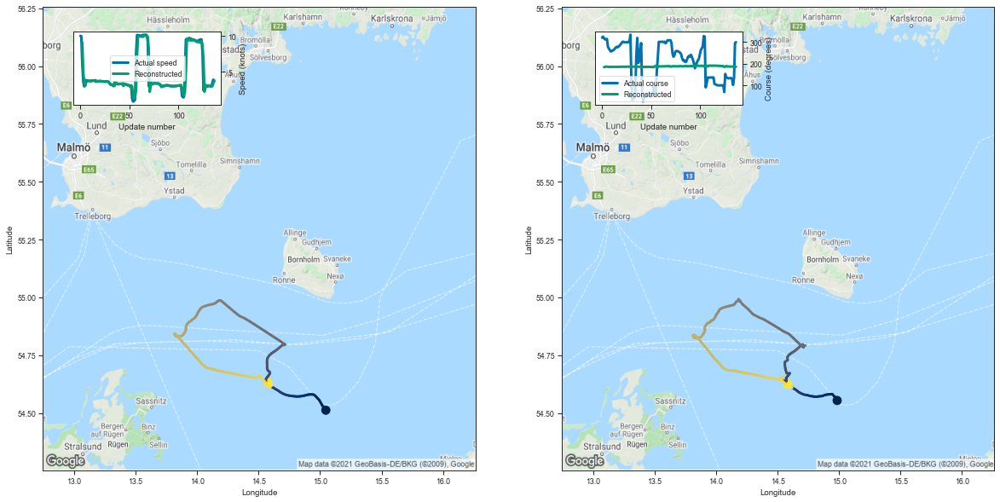

[9.124202728271484, 5.106858730316162, 3.5219221115112305, 3.0770983695983887]


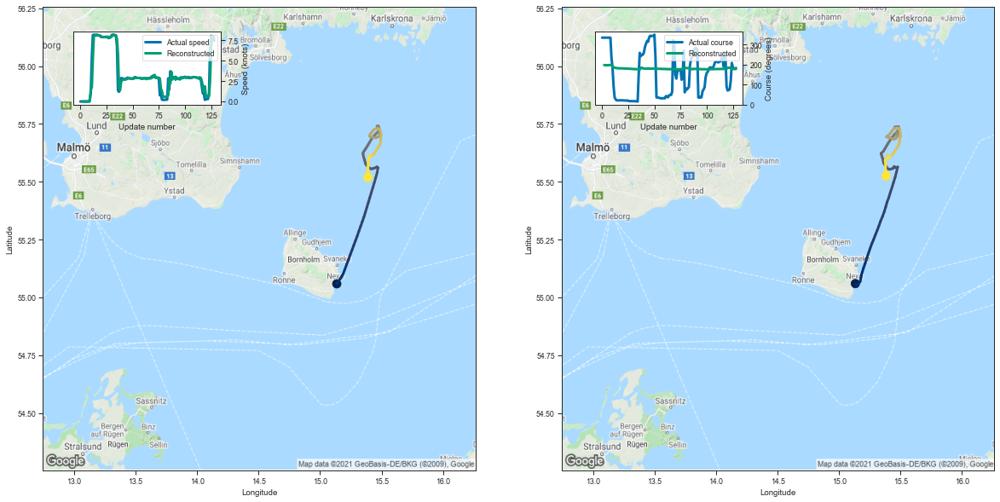

[-0.014859914779663086, -0.010291099548339844, -0.013034582138061523, -0.01483917236328125]


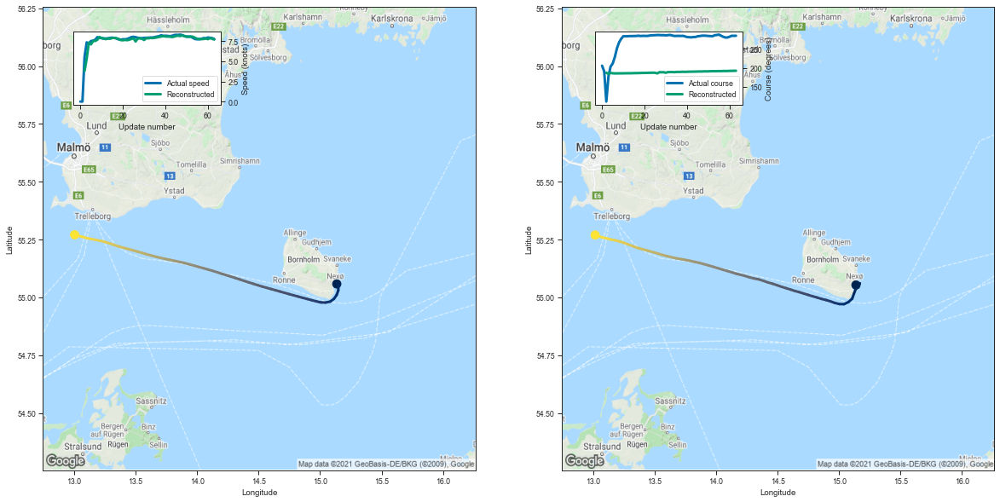

[3.793928623199463, 5.365303993225098, 7.325425624847412, 7.1068339347839355]


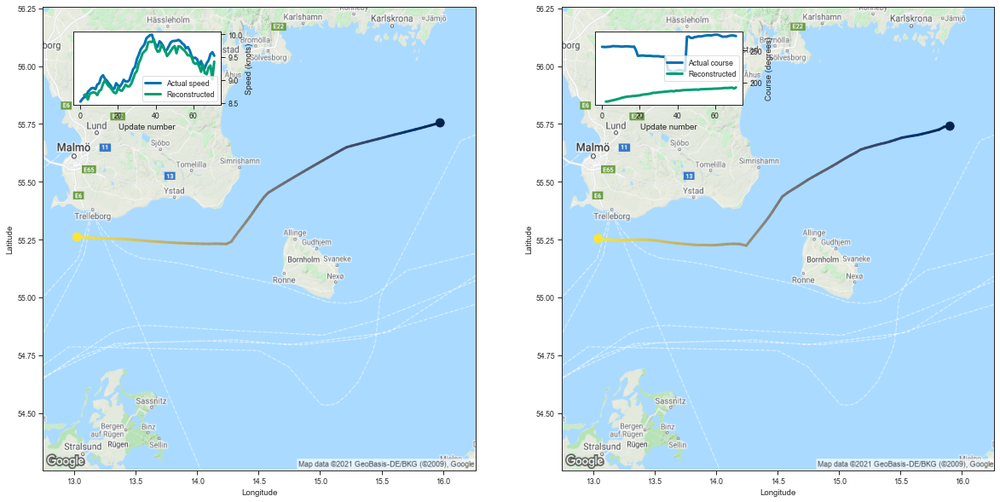

[8.671039581298828, 8.692399978637695, 8.574525833129883, 8.69959545135498]


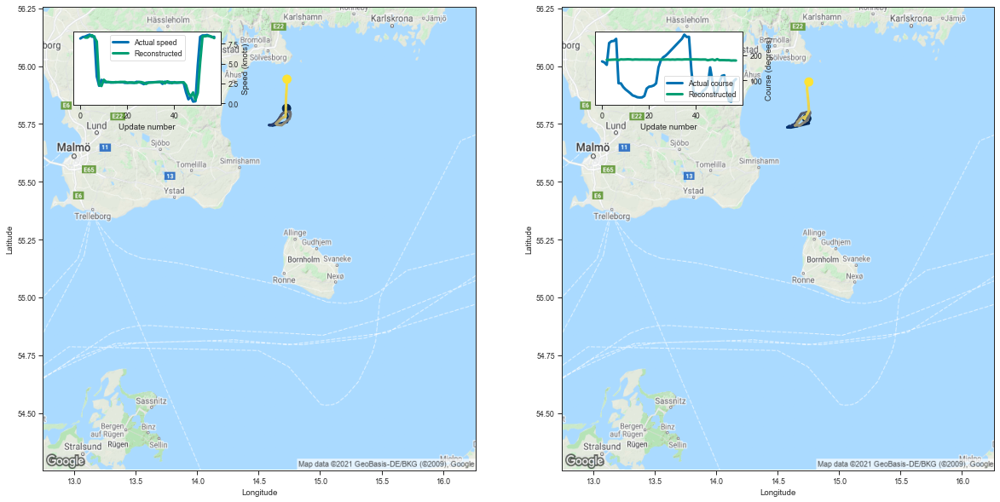

[8.279447555541992, 8.270703315734863, 8.496572494506836, 8.58182430267334]


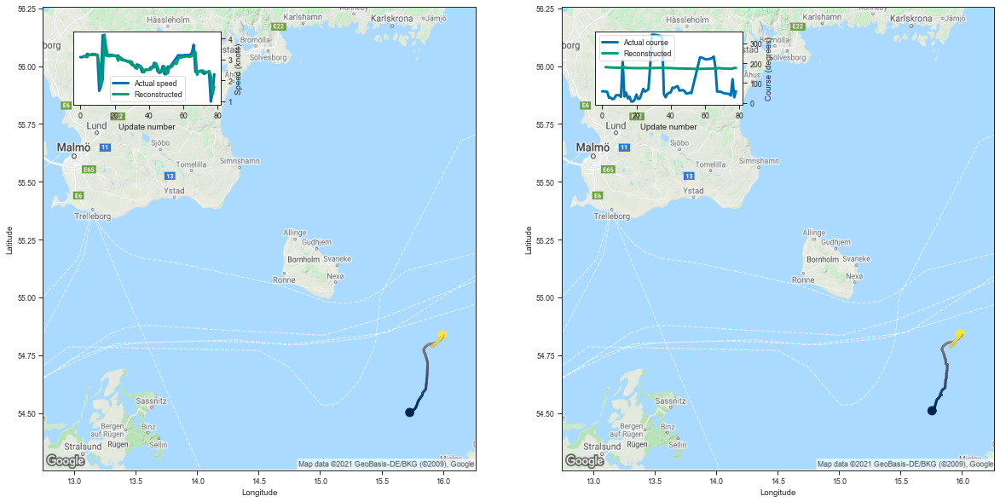

[3.1280694007873535, 3.1270487308502197, 3.10703706741333, 3.228436231613159]


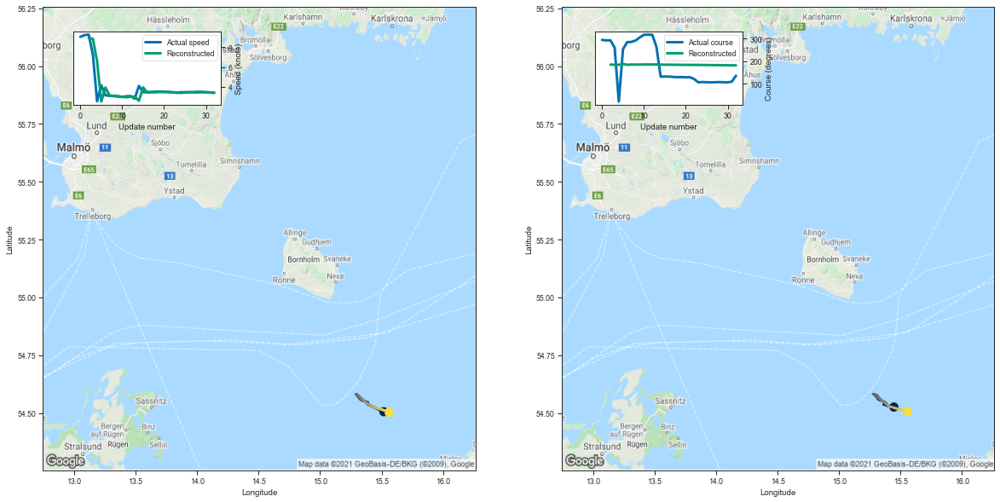

[8.90530776977539, 8.828679084777832, 6.56891393661499, 2.5332114696502686]


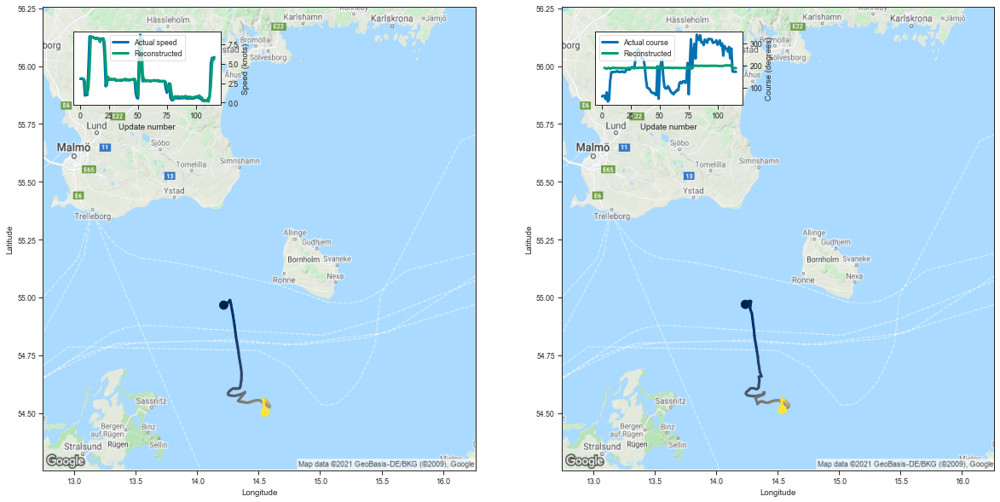

[3.1026949882507324, 3.0260844230651855, 2.6783342361450195, 1.1665260791778564]


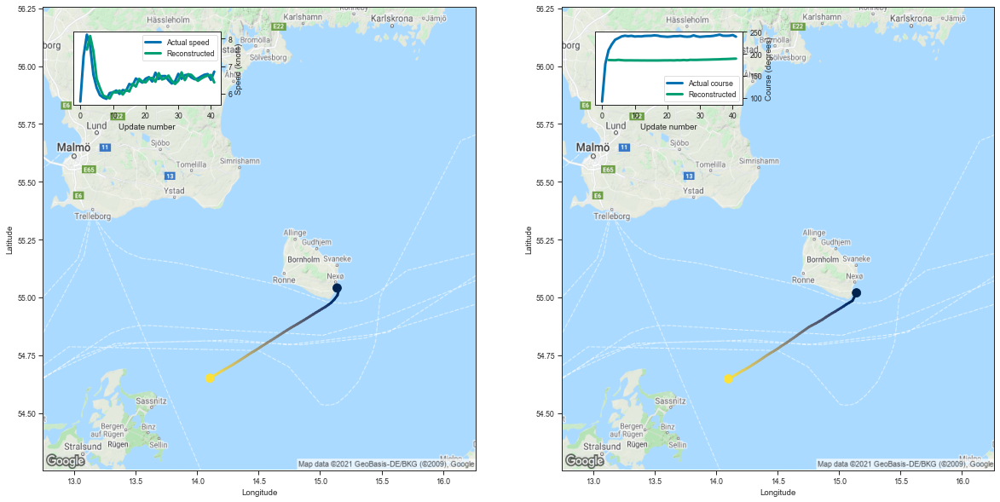

[7.597000598907471, 8.089798927307129, 7.538195610046387, 6.536485195159912]


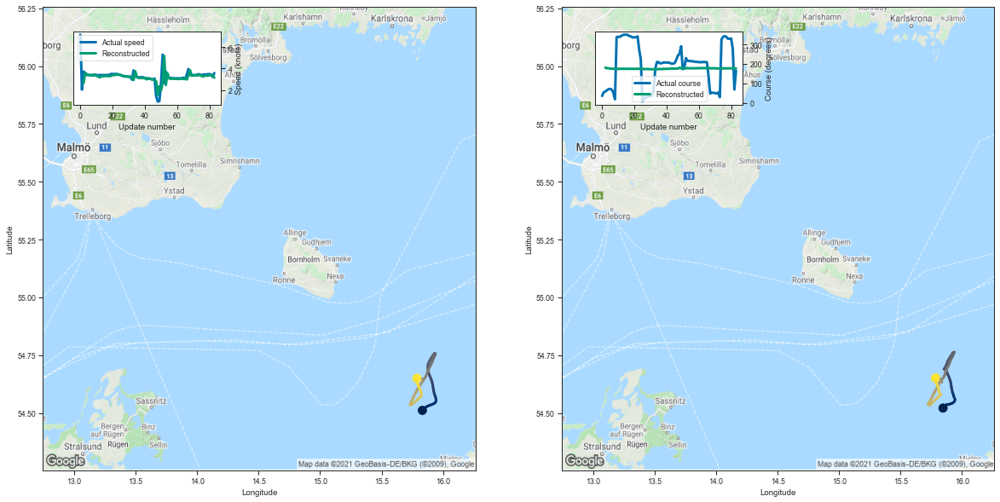

[2.646303176879883, 3.5964479446411133, 3.4815175533294678, 3.399791955947876]


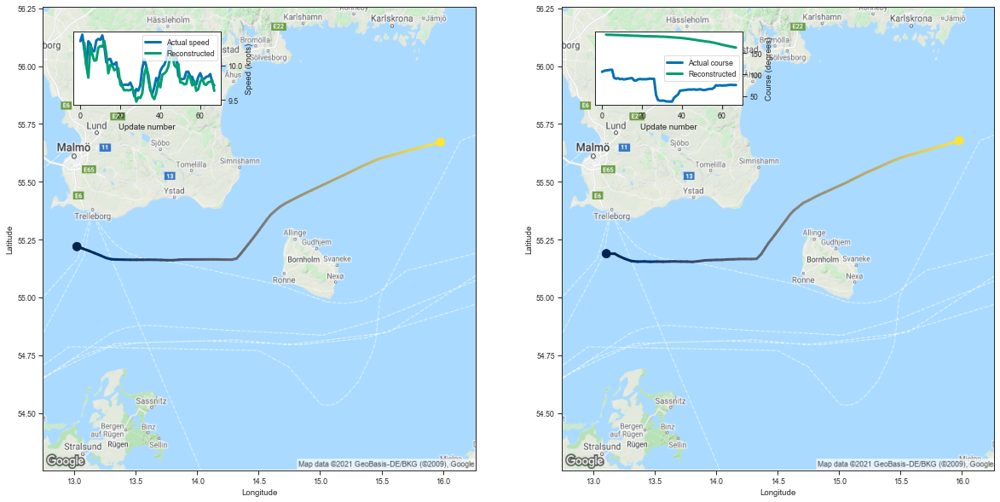

[10.318572998046875, 10.001582145690918, 9.82248306274414, 10.272302627563477]


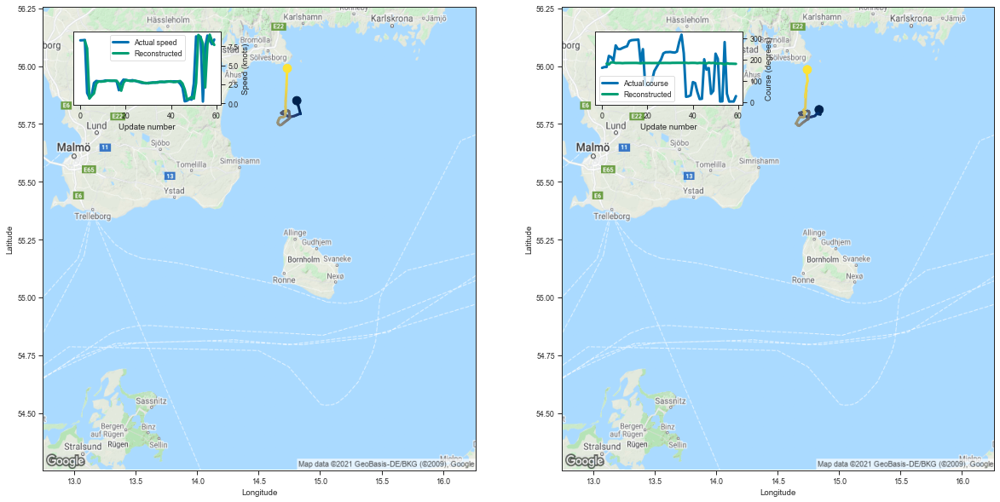

[8.221366882324219, 7.235689640045166, 0.6311959028244019, 1.002252459526062]


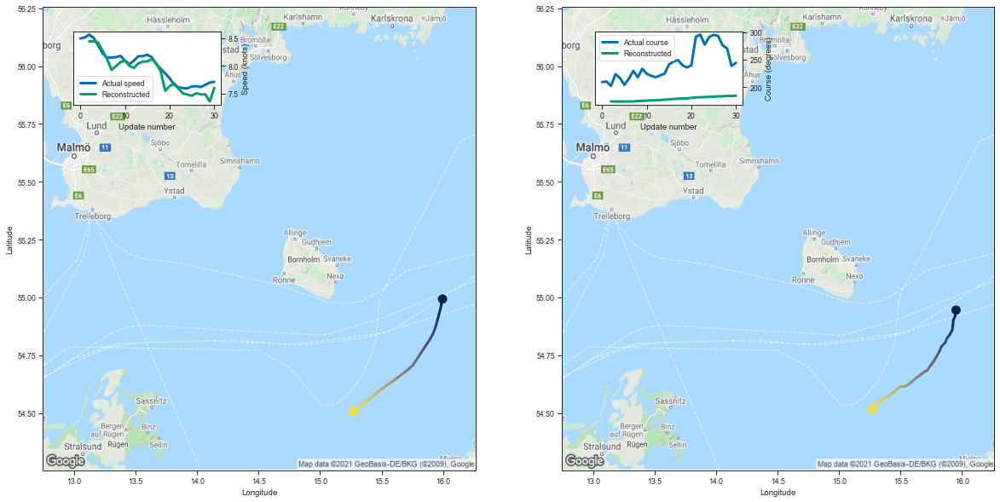

[8.441794395446777, 8.439678192138672, 8.415826797485352, 8.268444061279297]


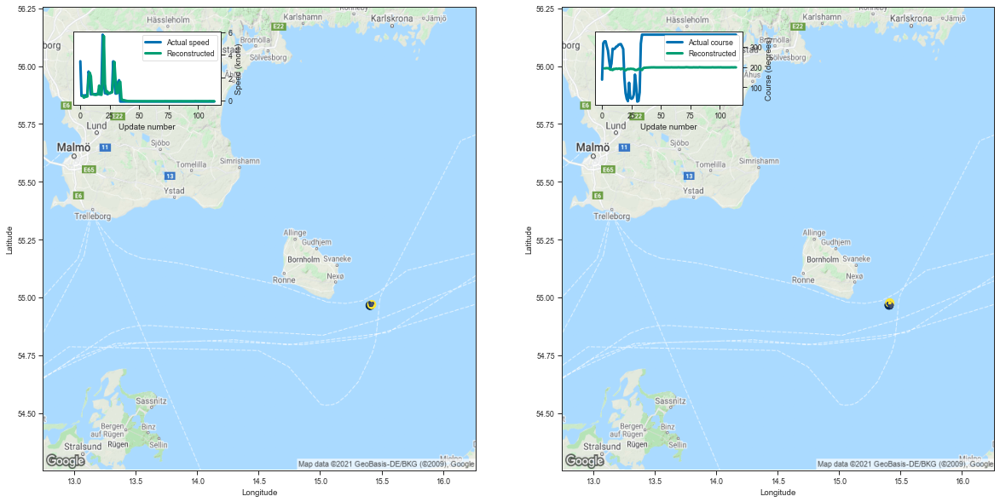

[0.422709584236145, 0.24353432655334473, 0.2996436357498169, 0.3264428377151489]


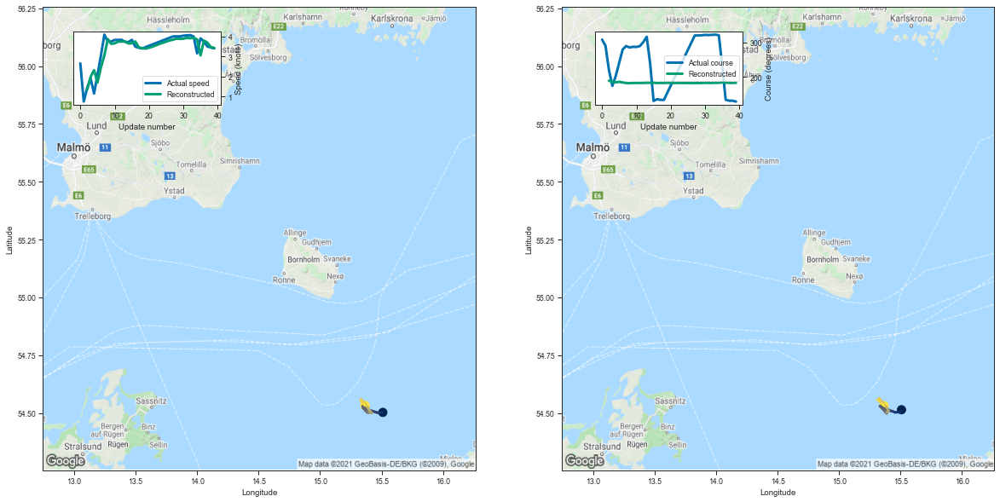

[1.3455920219421387, 1.9869388341903687, 2.315253973007202, 1.699049711227417]


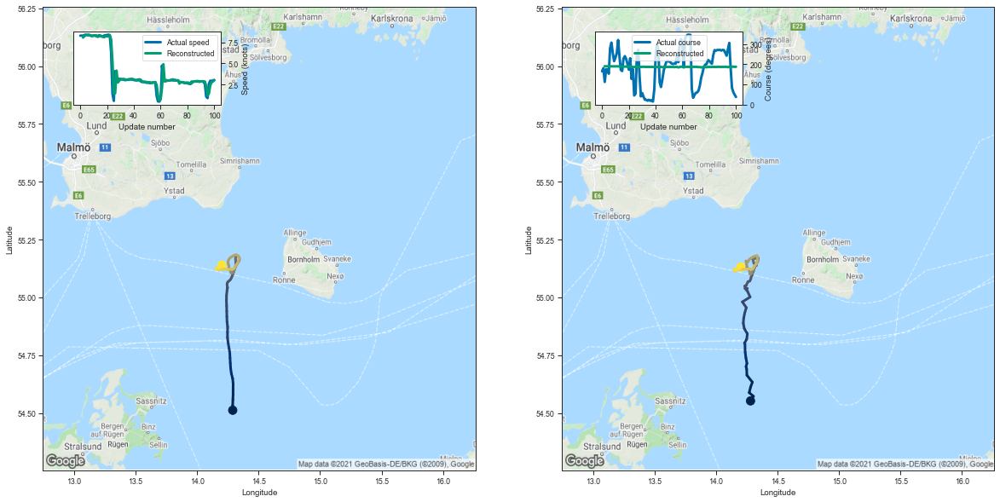

[8.089282035827637, 8.234569549560547, 8.382262229919434, 8.407759666442871]


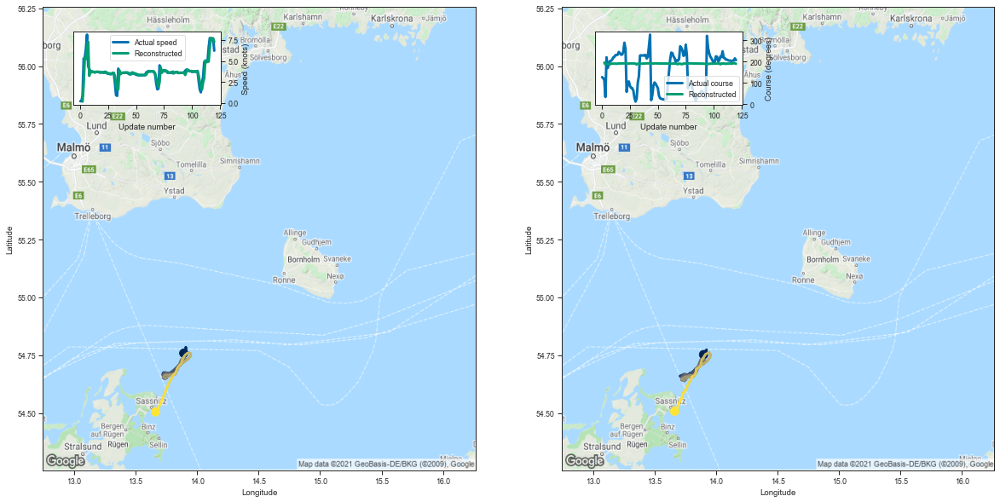

[0.15715420246124268, 2.2493536472320557, 5.354851245880127, 5.235350608825684]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
25,25,7292936,266054000,Fishing,144,1151.977295,7.999842
34,34,7237328,266054000,Fishing,144,1146.112061,7.959112
44,44,7135380,266054000,Fishing,144,1145.696411,7.956225
74,74,6962046,265759000,Fishing,143,1104.906494,7.726619
17,17,6685896,265759000,Fishing,143,1104.594727,7.724439
...,...,...,...,...,...,...,...
1,1,4547326,261061000,Fishing,31,25.942585,0.836858
56,56,4380691,261017210,Fishing,115,95.558426,0.830943
68,68,4217381,261006090,Fishing,40,32.617081,0.815427
48,48,4303656,261007170,Fishing,101,69.212357,0.685271


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n